# Машинное обучение, ФКН ВШЭ

# Практическое задание 10. Обучение без учителя.

## Общая информация
Дата выдачи: 10.04.2023

Мягкий дедлайн: 24.04.2022 23:59 MSK

Жёсткий дедлайн: 30.04.2022 23:59 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). 

Сдавать задание после указанного срока сдачи нельзя.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-10-Username.ipynb

Username — ваша фамилия на латинице

## О задании

В этом задании мы посмотрим на несколько алгоритмов кластеризации и применим их к географическим и текстовым данным. Также мы подробно остановимся на тематическом моделировании текстов, задаче обучения представлений и в каком-то смысле поработаем с semi-supervised learning. 



In [2]:
import pandas as pd
import numpy as np
from scipy.spatial import distance_matrix
np.random.seed(0xFFFFFFF)
import networkx as nx
from sklearn.cluster import SpectralClustering

### **Задание 0 (1e-100 балла)**. Опишите свои ощущения от домашки по ЕМ-алгоритму (можно картинкой или мемом).

In [3]:
# YOUR CODE HERE (ノಠ益ಠ)ノ彡┻━┻

## Часть 1. Кластеризация автобусных остановок

В этом задании мы сравним разные алгоритмы кластеризации для данных об автобусных остановках Москвы.

**Задание 1.1 (1 балл).** Реализуйте алгоритм спектральной кластеризации, который упоминался на лекции. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Напомним, что для графа с матрицей смежности $W = \{w_{ij}\}_{i, j = 1 \dots \ell}$ лапласиан определяется как:

$$
L = D - W,
$$

где $D = \text{diag}(d_1, ..., d_{\ell}), d_i = \sum_{j=1}^{\ell} w_{ij}$.

In [4]:
from numpy.linalg import eig

In [5]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans
from scipy.sparse.linalg import eigsh

class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''

        eigenvectors = self._generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''
        D = np.diag(np.sum(X, axis =1))
        L = D - X
        eigenwert, eigenvector = eigsh(L, which = 'SM')
        return eigenvector
        raise NotImplementedError

Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [6]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Теперь можем приступить к работе с реальными данными. Скачайте файл с данными об остановках общественного транспорта **в формате .xlsx** по [ссылке](https://data.mos.ru/opendata/download/60464/1/201) (так гарантированно не возникнет проблем с парсингом файла) и загрузите таблицу в ноутбук. Если вдруг сайт Правительства Москвы сойдет с ума, то возьмите какую-нибудь версию данных [отсюда](https://data.mos.ru/opendata/7704786030-city-surface-public-transport-stops). Для удобства визуализации мы будем работать только с остановками в ЦАО.

In [7]:
data = pd.read_excel('transport.xlsx')
data = data[data.AdmArea_en == "Czentral`ny'j administrativny'j okrug"]
data = data.reset_index()
data.head()

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
0,278,347,"«2-й Лесной пер.», улица Бутырский Вал (347)",37.586584,55.782106,улица Бутырский Вал,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ18; А12; АТ56; АТ78,2-й Лесной пер.,NaN,да,ГУП «Мосгортранс»,active,889085436,NaN
1,279,349,"«Ул. Сущевский Вал», Новослободская улица (349)",37.590714,55.790630,Новослободская улица,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ47; АМ10; АТ3; АТ56; АТ78,Ул. Сущевский Вал,NaN,да,ГУП «Мосгортранс»,active,889085437,NaN
2,355,479,"«Стадион Лужники (южн.) (пос.)», улица Лужники...",37.565972,55.714265,улица Лужники,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Стадион Лужники (южн.) (пос.),NaN,да,ГУП «Мосгортранс»,active,889085549,NaN
3,356,480,"«Спортзал Дружба», Лужнецкая набережная (480)",37.570191,55.712504,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Спортзал Дружба,NaN,да,ГУП «Мосгортранс»,active,889085550,NaN
4,357,481,"«Лужнецкая наб.», Лужнецкая набережная (481)",37.574559,55.713770,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Лужнецкая наб.,NaN,да,ГУП «Мосгортранс»,active,889085551,NaN


In [8]:
pip install folium

  Using cached folium-0.14.0-py2.py3-none-any.whl (102 kB)
  Using cached branca-0.6.0-py3-none-any.whl (24 kB)
Note: you may need to restart the kernel to use updated packages.


Воспользуемся библиотекой `folium` для визуализации данных.

In [433]:
import folium

map = folium.Map([55.75215, 37.61819], zoom_start=12)
for id, row in data.iterrows():
    folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=10).add_to(map)
map

**Задание 1.2 (1 балл).** Попробуем построить граф, в котором вершинами будут остановки. Как вы уже могли заметить, для каждой остановки указаны номера маршрутов, проходящих через неё. Логично соединить ребрами соседние остановки каждого маршрута. Однако мы не знаем, в каком порядке автобусы объезжают остановки. Но мы можем применить эвристический алгоритм, который восстановит нам порядок маршрутов:

* Для каждого маршрута выделим список всех остановок, через которые он проходит.
* Выберем начальную остановку маршрута как точку, наиболее удаленную от всех остальных остановок этого маршрута.
* Каждую следующую точку маршрута будем выбирать как самую близкую из оставшихся точек (не включенных в маршрут ранее).

Фактически, у нас получается жадное решение задачи коммивояжера. Когда мы отсортировали маршруты, можем построить по ним граф. Будем строить его по таким правилам:

* Между двумя остановками будет ребро, если они являются соседними хотя бы на одном маршруте. Вес ребра равен числу маршрутов, на которых остановки являются соседними.
* В графе не будет петель (то есть у матрицы смежности будет нулевая диагональ).

Реализуйте предложенный способ построения графа. Для этого рекомендуется воспользоваться шаблонами, приведенными ниже.

In [318]:
data[['ID_en','RouteNumbers_en']]

,ID_en,RouteNumbers_en
0,347,АТ18; А12; АТ56; АТ78
1,349,АТ47; АМ10; АТ3; АТ56; АТ78
2,479,А64; А216; А809; АС12; А255; АБК; АТ79
3,480,А64; А216; А809; АС12; А255; АБК; АТ79
4,481,А64; А216; А809; АС12; А255; АБК; АТ79
...,...,...
1032,5099,АК
1033,1009191,А869
1034,1009193,АМ71
1035,1009239,АО47


In [319]:
new_data = data[['ID_en','RouteNumbers_en']]
new_data.set_index('ID_en', inplace = True)

In [320]:
new_data

,RouteNumbers_en
ID_en,
347,АТ18; А12; АТ56; АТ78
349,АТ47; АМ10; АТ3; АТ56; АТ78
479,А64; А216; А809; АС12; А255; АБК; АТ79
480,А64; А216; А809; АС12; А255; АБК; АТ79
481,А64; А216; А809; АС12; А255; АБК; АТ79
...,...
5099,АК
1009191,А869
1009193,АМ71


In [321]:
d = new_data['RouteNumbers_en'].str.split('; ').to_dict()

In [322]:
new_dic = {}
for k,v in d.items():
    for x in v:
        new_dic.setdefault(x,[]).append(k)

Господи спасибо за умных людей на стэк оверфлоу

https://stackoverflow.com/questions/35491223/inverting-a-dictionary-with-list-values

In [323]:
new_dic

{'АТ18': [347,
  619,
  643,
  644,
  1501,
  1502,
  2954,
  2955,
  2956,
  2957,
  2958,
  2959,
  2960,
  2961,
  2975,
  2976,
  2977,
  2978,
  2979,
  2980,
  2981,
  2982,
  3549,
  3554,
  3555,
  7013,
  10427,
  13215,
  14470,
  14473,
  1001851,
  1499,
  1500,
  3181,
  3550,
  3551,
  3552,
  3553,
  7963,
  10428],
 'А12': [347,
  619,
  1501,
  1502,
  2954,
  2955,
  2956,
  2957,
  2958,
  2959,
  2960,
  2961,
  2965,
  2975,
  2976,
  2977,
  2978,
  2979,
  2980,
  2981,
  2982,
  3180,
  3549,
  6572,
  13522,
  13523,
  14470,
  14473,
  1001851,
  1499,
  1500,
  2962,
  2963,
  2964,
  3181],
 'АТ56': [347, 349, 1501, 1502, 14470, 1001850, 1002945, 1499, 1500],
 'АТ78': [347, 349, 1501, 1502, 14470, 1001850, 1002945, 1499, 1500],
 'АТ47': [349,
  3378,
  3379,
  6178,
  8820,
  10135,
  10136,
  1001915,
  1001998,
  3365,
  3366,
  3367,
  3368,
  3369,
  3377,
  3380,
  3473,
  6082,
  10682,
  1001994],
 'АМ10': [349,
  3378,
  3379,
  6464,
  10135,
  1013

In [324]:
example = [347, 1501, 1502, 2965, 3549, 6572, 13522, 13523, 14470, 14473, 1499, 1500, 2962, 2963, 2964]


In [293]:
df = data[data['ID_en'].isin(example)]

https://stackoverflow.com/questions/35491223/inverting-a-dictionary-with-list-values

In [294]:
df = df[['ID_en', 'Longitude_WGS84_en', 'Latitude_WGS84_en']]
df.set_index('ID_en', inplace = True)
dist_mat = pd.DataFrame(distance_matrix(df.values, df.values), index=list(df.index), columns=list(df.index))






In [295]:
dist_mat

,347,1501,1502,2965,3549,6572,13522,13523,14470,14473,1499,1500,2962,2963,2964
347,0.000000,0.002452,0.000920,0.058127,0.047777,0.053542,0.060443,0.054327,0.004906,0.003947,0.003662,0.006684,0.045258,0.049943,0.052613
1501,0.002452,0.000000,0.003281,0.059688,0.049346,0.055038,0.061917,0.055949,0.007320,0.006353,0.001285,0.004250,0.046952,0.051619,0.054254
1502,0.000920,0.003281,0.000000,0.057270,0.046920,0.052698,0.059602,0.053459,0.004039,0.003073,0.004529,0.007530,0.044379,0.049067,0.051742
2965,0.058127,0.059688,0.057270,0.000000,0.010350,0.004999,0.003518,0.004211,0.054401,0.055039,0.060852,0.062964,0.013360,0.008819,0.005997
3549,0.047777,0.049346,0.046920,0.010350,0.000000,0.006054,0.012899,0.006743,0.044069,0.044699,0.050515,0.052654,0.004082,0.003651,0.005269
6572,0.053542,0.055038,0.052698,0.004999,0.006054,0.000000,0.006919,0.003750,0.049945,0.050551,0.056185,0.058234,0.009780,0.006161,0.004259
13522,0.060443,0.061917,0.059602,0.003518,0.012899,0.006919,0.000000,0.007540,0.056864,0.057468,0.063057,0.065071,0.016324,0.011997,0.009249
13523,0.054327,0.055949,0.053459,0.004211,0.006743,0.003750,0.007540,0.000000,0.050502,0.051162,0.057131,0.059316,0.009259,0.004632,0.001801
14470,0.004906,0.007320,0.004039,0.054401,0.044069,0.049945,0.056864,0.050502,0.000000,0.000968,0.008562,0.011569,0.041333,0.046037,0.048758
14473,0.003947,0.006353,0.003073,0.055039,0.044699,0.050551,0.057468,0.051162,0.000968,0.000000,0.007599,0.010603,0.042014,0.046715,0.049425


In [425]:
df

,Longitude_WGS84_en,Latitude_WGS84_en
ID_en,,
1000562,37.709265,55.773197
1000563,37.702076,55.769823


In [297]:
dist_mat

,347,1501,1502,2965,3549,6572,13522,13523,14470,14473,1499,1500,2962,2963,2964
347,0.000000,0.002452,0.000920,0.058127,0.047777,0.053542,0.060443,0.054327,0.004906,0.003947,0.003662,0.006684,0.045258,0.049943,0.052613
1501,0.002452,0.000000,0.003281,0.059688,0.049346,0.055038,0.061917,0.055949,0.007320,0.006353,0.001285,0.004250,0.046952,0.051619,0.054254
1502,0.000920,0.003281,0.000000,0.057270,0.046920,0.052698,0.059602,0.053459,0.004039,0.003073,0.004529,0.007530,0.044379,0.049067,0.051742
2965,0.058127,0.059688,0.057270,0.000000,0.010350,0.004999,0.003518,0.004211,0.054401,0.055039,0.060852,0.062964,0.013360,0.008819,0.005997
3549,0.047777,0.049346,0.046920,0.010350,0.000000,0.006054,0.012899,0.006743,0.044069,0.044699,0.050515,0.052654,0.004082,0.003651,0.005269
6572,0.053542,0.055038,0.052698,0.004999,0.006054,0.000000,0.006919,0.003750,0.049945,0.050551,0.056185,0.058234,0.009780,0.006161,0.004259
13522,0.060443,0.061917,0.059602,0.003518,0.012899,0.006919,0.000000,0.007540,0.056864,0.057468,0.063057,0.065071,0.016324,0.011997,0.009249
13523,0.054327,0.055949,0.053459,0.004211,0.006743,0.003750,0.007540,0.000000,0.050502,0.051162,0.057131,0.059316,0.009259,0.004632,0.001801
14470,0.004906,0.007320,0.004039,0.054401,0.044069,0.049945,0.056864,0.050502,0.000000,0.000968,0.008562,0.011569,0.041333,0.046037,0.048758
14473,0.003947,0.006353,0.003073,0.055039,0.044699,0.050551,0.057468,0.051162,0.000968,0.000000,0.007599,0.010603,0.042014,0.046715,0.049425


In [298]:
dist_mat_sum = pd.DataFrame(dist_mat.sum(axis=1))
dist_mat_sum

,0
347,0.444602
1501,0.459704
1502,0.438510
2965,0.459594
3549,0.385030
6572,0.418116
13522,0.492869
13523,0.419782
14470,0.429273
14473,0.429616


In [299]:
example

[347,
 1501,
 1502,
 2965,
 3549,
 6572,
 13522,
 13523,
 14470,
 14473,
 1499,
 1500,
 2962,
 2963,
 2964]

In [300]:
first_stop = dist_mat_sum[[0]].idxmax()[0]
first_stop

1500

In [301]:
sorted_stops = []
sorted_stops.append(first_stop)
for i in range(len(example)-1):
    dist_mat = dist_mat.drop(first_stop)
    a = pd.DataFrame(dist_mat[first_stop])
    first_stop = list(a.idxmin())[0]
    sorted_stops.append(first_stop)
    print(sorted_stops)

[1500, 1499]
[1500, 1499, 1501]
[1500, 1499, 1501, 347]
[1500, 1499, 1501, 347, 1502]
[1500, 1499, 1501, 347, 1502, 14473]
[1500, 1499, 1501, 347, 1502, 14473, 14470]
[1500, 1499, 1501, 347, 1502, 14473, 14470, 2962]
[1500, 1499, 1501, 347, 1502, 14473, 14470, 2962, 3549]
[1500, 1499, 1501, 347, 1502, 14473, 14470, 2962, 3549, 2963]
[1500, 1499, 1501, 347, 1502, 14473, 14470, 2962, 3549, 2963, 2964]
[1500, 1499, 1501, 347, 1502, 14473, 14470, 2962, 3549, 2963, 2964, 13523]
[1500, 1499, 1501, 347, 1502, 14473, 14470, 2962, 3549, 2963, 2964, 13523, 6572]
[1500, 1499, 1501, 347, 1502, 14473, 14470, 2962, 3549, 2963, 2964, 13523, 6572, 2965]
[1500, 1499, 1501, 347, 1502, 14473, 14470, 2962, 3549, 2963, 2964, 13523, 6572, 2965, 13522]


In [302]:
len(sorted_stops)


15

In [303]:
len(example)



15

{347: ['АТ18', ' А12', ' АТ56', ' АТ78'],
 349: ['АТ47', ' АМ10', ' АТ3', ' АТ56', ' АТ78'],
 479: ['А64', ' А216', ' А809', ' АС12', ' А255', ' АБК', ' АТ79'],
 480: ['А64', ' А216', ' А809', ' АС12', ' А255', ' АБК', ' АТ79'],
 481: ['А64', ' А216', ' А809', ' АС12', ' А255', ' АБК', ' АТ79'],
 482: ['А64', ' А216', ' АС12', ' А255', ' АМ3'],
 483: ['А64', ' А15', ' АС12', ' А255', ' АМ3'],
 485: ['А64', ' АС12'],
 486: ['А64', ' А216', ' А809', ' А255'],
 487: ['А64', ' А216', ' А809', ' А255'],
 488: ['А64', ' АБК', ' АС12', ' АТ10', ' АТ39', ' АТ79'],
 489: ['А64', ' АБК', ' А869', ' АТ10', ' АТ39', ' АТ79'],
 491: ['А850', ' А64', ' АС43', ' А869', ' АМ6', ' АТ79'],
 493: ['А64', ' А39', ' АС43', ' А869', ' АМ6', ' АТ35', ' АТ79'],
 501: ['А64', ' А39', ' АС43', ' А869', ' АМ6', ' АТ35', ' АТ79'],
 502: ['А64', ' А39', ' АС43', ' А869', ' АМ6', ' АТ35', ' АТ79'],
 503: ['А850', ' А64', ' А39', ' АС43', ' А69', ' А869', ' АМ6', ' АТ79'],
 504: ['А64', ' А869', ' АТ10', ' АБ', ' АТ

In [325]:
new_dic = {}
for k,v in d.items():
    for x in v:
        new_dic.setdefault(x,[]).append(k)
n = 0
for j in new_dic:
    if len(new_dic[j]) != 1:
        example = new_dic[j]
        
        df = data[data['ID_en'].isin(example)]
        df = df[['ID_en', 'Longitude_WGS84_en', 'Latitude_WGS84_en']]
        df.set_index('ID_en', inplace = True)
        dist_mat = pd.DataFrame(distance_matrix(df.values, df.values), index=list(df.index), columns=list(df.index))
        dist_mat_sum = pd.DataFrame(dist_mat.sum(axis=1))
        first_stop = dist_mat_sum[[0]].idxmax()[0]
        sorted_stops = []
        sorted_stops = []
        sorted_stops.append(first_stop)
        for i in range(len(example)-1):
            dist_mat = dist_mat.drop(first_stop)
            a = pd.DataFrame(dist_mat[first_stop])
            first_stop = list(a.idxmin())[0]
            sorted_stops.append(first_stop)
        new_dic[j] = sorted_stops


##  Добавляем в граф

https://github.com/hse-ds/iad-applied-ds/blob/master/2023/seminars/sem08_graphs/sem08_graphs.ipynb

In [362]:
nodges = []
for i in new_dic.values():
    for first, second in zip(i, i[1:]):
        nod = (first, second)
        nodges.append(nod)

Между двумя остановками будет ребро, если они являются соседними хотя бы на одном маршруте. Вес ребра равен числу маршрутов, на которых остановки являются соседними.

In [406]:
nodges

[[7013, 13215],
 [13215, 644],
 [644, 643],
 [643, 619],
 [619, 3181],
 [3181, 1500],
 [1500, 1499],
 [1499, 1501],
 [1501, 347],
 [347, 1502],
 [1502, 14473],
 [14473, 14470],
 [14470, 1001851],
 [1001851, 2954],
 [2954, 2982],
 [2982, 2955],
 [2955, 2981],
 [2981, 2980],
 [2980, 2956],
 [2956, 2957],
 [2957, 2979],
 [2979, 2978],
 [2978, 2958],
 [2958, 2977],
 [2977, 2959],
 [2959, 2960],
 [2960, 2976],
 [2976, 2975],
 [2975, 2961],
 [2961, 3549],
 [3549, 3555],
 [3555, 3550],
 [3550, 3554],
 [3554, 3551],
 [3551, 3553],
 [3553, 3552],
 [3552, 7963],
 [7963, 10428],
 [10428, 10427],
 [619, 3181],
 [3181, 1500],
 [1500, 1499],
 [1499, 1501],
 [1501, 347],
 [347, 1502],
 [1502, 14473],
 [14473, 14470],
 [14470, 1001851],
 [1001851, 2954],
 [2954, 2982],
 [2982, 2955],
 [2955, 2981],
 [2981, 2980],
 [2980, 2956],
 [2956, 2957],
 [2957, 2979],
 [2979, 2978],
 [2978, 2958],
 [2958, 2977],
 [2977, 2959],
 [2959, 2960],
 [2960, 2976],
 [2976, 2975],
 [2975, 2961],
 [2961, 3180],
 [3180, 296

In [418]:
m = 0
weights = {}
for i in [nodges][0]:
    i_rev = ' '.join(str(e) for e in i[::-1])
    i = ' '.join(str(e) for e in i)
    if i in weights :
        weights[i] += 1
        #print(weights)
    elif i_rev in weights: 
        weights[i_rev] += 1
        #print(weights)
    else:
        weights[i] = 1
        #print(weights)


    

In [419]:
weights

{'7013 13215': 3,
 '13215 644': 4,
 '644 643': 4,
 '643 619': 4,
 '619 3181': 2,
 '3181 1500': 2,
 '1500 1499': 4,
 '1499 1501': 4,
 '1501 347': 4,
 '347 1502': 4,
 '1502 14473': 3,
 '14473 14470': 2,
 '14470 1001851': 2,
 '1001851 2954': 2,
 '2954 2982': 2,
 '2982 2955': 4,
 '2955 2981': 4,
 '2981 2980': 3,
 '2980 2956': 3,
 '2956 2957': 3,
 '2957 2979': 3,
 '2979 2978': 3,
 '2978 2958': 3,
 '2958 2977': 3,
 '2977 2959': 3,
 '2959 2960': 3,
 '2960 2976': 6,
 '2976 2975': 6,
 '2975 2961': 6,
 '2961 3549': 4,
 '3549 3555': 6,
 '3555 3550': 1,
 '3550 3554': 3,
 '3554 3551': 3,
 '3551 3553': 2,
 '3553 3552': 3,
 '3552 7963': 1,
 '7963 10428': 1,
 '10428 10427': 3,
 '2961 3180': 2,
 '3180 2962': 1,
 '2962 3549': 2,
 '3549 2963': 2,
 '2963 2964': 2,
 '2964 13523': 2,
 '13523 6572': 2,
 '6572 2965': 2,
 '2965 13522': 1,
 '349 1500': 2,
 '1502 1002945': 2,
 '1002945 14470': 2,
 '14470 1001850': 2,
 '8820 6178': 2,
 '6178 6082': 2,
 '6082 1001994': 3,
 '1001994 1001998': 1,
 '1001998 1001915':

In [420]:
G = nx.Graph()
for i in weights: 
    first = i.split(' ')[0]
    second = i.split(' ')[1]
    G.add_edge(first, second, weight= weights[i])


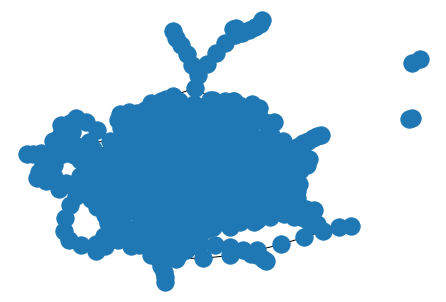

In [421]:
nx.draw(G)

In [422]:
A = np.array(nx.adjacency_matrix(G).todense()).T
A

array([[0, 3, 0, ..., 0, 0, 0],
       [3, 0, 4, ..., 0, 0, 0],
       [0, 4, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 1],
       [0, 0, 0, ..., 0, 1, 0]])

In [434]:
def get_routes(data):
    '''
    Accumulate routes from raw data
    param data: pd.DataFrame - public transport stops data
    return: dict - unsorted stops ids for each route,
                   e.g. routes['A1'] = [356, 641, 190]
    '''

    data[['ID_en','RouteNumbers_en']]
    new_data = data[['ID_en','RouteNumbers_en']]
    new_data.set_index('ID_en', inplace = True)
    d = new_data['RouteNumbers_en'].str.split(';').to_dict()
    new_dic = {}
    for k,v in d.items():
        for x in v:
            new_dic.setdefault(x,[]).append(k)
    routes = new_dic
    return routes
    raise NotImplementedError


def sort_routes(data, routes):
    '''
    Sort routes according to the proposed algorithm
    param data: pd.DataFrame - public transport stops data
    param routes: dict - unsorted stops ids for each route
    return: dict - sorted stops ids for each route
    '''
    new_dic = routes
    for j in new_dic:
        if len(new_dic[j]) != 1:
            example = new_dic[j]

            df = data[data['ID_en'].isin(example)]
            df = df[['ID_en', 'Longitude_WGS84_en', 'Latitude_WGS84_en']]
            df.set_index('ID_en', inplace = True)
            dist_mat = pd.DataFrame(distance_matrix(df.values, df.values), index=list(df.index), columns=list(df.index))
            dist_mat_sum = pd.DataFrame(dist_mat.sum(axis=1))
            first_stop = dist_mat_sum[[0]].idxmax()[0]
            sorted_stops = []
            sorted_stops = []
            sorted_stops.append(first_stop)
            for i in range(len(example)-1):
                dist_mat = dist_mat.drop(first_stop)
                a = pd.DataFrame(dist_mat[first_stop])
                first_stop = list(a.idxmin())[0]
                sorted_stops.append(first_stop)
            new_dic[j] = sorted_stops
    sorted_routes = new_dic
    return sorted_routes
    raise NotImplementedError


def get_adjacency_matrix(data, sorted_routes):
    '''
    Compute adjacency matrix for sorted routes
    param data: pd.DataFrame - public transport stops data
    param sorted_routes: dict - sorted stops ids for each route
    return: (n_samples, n_samples) - graph adjacency matrix
    '''

    nodges = []
    for i in new_dic.values():
        for first, second in zip(i, i[1:]):
            nod = (first, second)
            nodges.append(nod)
            
        
    weights = {}
    for i in [nodges][0]:
        i_rev = ' '.join(str(e) for e in i[::-1])
        i = ' '.join(str(e) for e in i)
        if i in weights :
            weights[i] += 1
            #print(weights)
        elif i_rev in weights: 
            weights[i_rev] += 1
            #print(weights)
        else:
            weights[i] = 1
    G = nx.Graph()
    for i in weights: 
        first = i.split(' ')[0]
        second = i.split(' ')[1]
        G.add_edge(first, second, weight= weights[i])
    A = np.array(nx.adjacency_matrix(G).todense()).T
    return A
    raise NotImplementedError

In [435]:
routes = get_routes(data)
sorted_routes = sort_routes(data, routes)
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)

Проверим, что маршруты получились адекватными. Для этого нарисуем их на карте.

In [522]:
data.set_index('ID_en', inplace = True)

In [459]:
map = folium.Map([55.75215, 37.61819], zoom_start=12)
for route_id in np.random.choice(list(sorted_routes.keys()), size=10):
    coords = data.loc[
        sorted_routes[route_id],
        ['Latitude_WGS84_en', 'Longitude_WGS84_en']
    ].values.tolist()
    folium.vector_layers.PolyLine(coords).add_to(map)

map

**Задание 1.3 (0 баллов)**. Реализуйте функцию `draw_clustered_map`, которая рисует карту центра Москвы с кластерами остановок, раскрашенными в разные цвета.

https://www.kaggle.com/code/lucaspcarlini/clustering-and-visualisation-using-folium-maps/notebook

In [464]:
data.head()

,index,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
ID_en,,,,,,,,,,,,,,,
347,278,"«2-й Лесной пер.», улица Бутырский Вал (347)",37.586584,55.782106,улица Бутырский Вал,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ18; А12; АТ56; АТ78,2-й Лесной пер.,NaN,да,ГУП «Мосгортранс»,active,889085436,NaN
349,279,"«Ул. Сущевский Вал», Новослободская улица (349)",37.590714,55.790630,Новослободская улица,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ47; АМ10; АТ3; АТ56; АТ78,Ул. Сущевский Вал,NaN,да,ГУП «Мосгортранс»,active,889085437,NaN
479,355,"«Стадион Лужники (южн.) (пос.)», улица Лужники...",37.565972,55.714265,улица Лужники,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Стадион Лужники (южн.) (пос.),NaN,да,ГУП «Мосгортранс»,active,889085549,NaN
480,356,"«Спортзал Дружба», Лужнецкая набережная (480)",37.570191,55.712504,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Спортзал Дружба,NaN,да,ГУП «Мосгортранс»,active,889085550,NaN
481,357,"«Лужнецкая наб.», Лужнецкая набережная (481)",37.574559,55.713770,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Лужнецкая наб.,NaN,да,ГУП «Мосгортранс»,active,889085551,NaN


In [469]:
data_clustered = data[['Longitude_WGS84_en', 'Latitude_WGS84_en']]
data_clustered

,Longitude_WGS84_en,Latitude_WGS84_en
ID_en,,
347,37.586584,55.782106
349,37.590714,55.790630
479,37.565972,55.714265
480,37.570191,55.712504
481,37.574559,55.713770
...,...,...
5099,37.637040,55.745463
1009191,37.554929,55.768215
1009193,37.634917,55.793561


In [470]:
data_clustered['cluster'] = labels.tolist()

<ipython-input-470-e8d5091e2347>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_clustered['cluster'] = labels.tolist()


In [471]:
data_clustered

,Longitude_WGS84_en,Latitude_WGS84_en,cluster
ID_en,,,
347,37.586584,55.782106,6
349,37.590714,55.790630,6
479,37.565972,55.714265,6
480,37.570191,55.712504,6
481,37.574559,55.713770,6
...,...,...,...
5099,37.637040,55.745463,0
1009191,37.554929,55.768215,1
1009193,37.634917,55.793561,1


In [479]:

from matplotlib import cm
from matplotlib import colors

In [492]:

map_clusters = folium.Map([55.75215, 37.61819], zoom_start=12)
n_clusters = 8
# set color scheme for the clusters
x = np.arange(n_clusters)
ys = [i + x + (i*x)**2 for i in range(n_clusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lng, cluster in zip(data['Latitude_WGS84_en'], data['Longitude_WGS84_en'],  
                                            labels):
    #label = folium.Popup(str(city)+ ','+str(state) + '- Cluster ' + str(cluster), parse_html=True)
    folium.vector_layers.CircleMarker(
        [lat, lng],
        radius=4,
        #popup=label,
        #tooltip = str(city)+ ','+str(state) + '- Cluster ' + str(cluster),
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.9).add_to(map_clusters)
       
map_clusters

In [544]:
def draw_clustered_map(data, labels):
    '''
    Create map with coloured clusters
    param data: pd.DataFrame - public transport stops data
    param labels: (n_samples, ) - cluster labels for each stop
    return: folium.Map - map with coloured clusters
    '''

    
    map_clusters = folium.Map([55.75215, 37.61819], zoom_start=12)
    n_clusters = len(np.unique(labels))
    # set color scheme for the clusters
    x = np.arange(n_clusters)
    ys = [i + x + (i*x)**2 for i in range(n_clusters)]
    colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
    rainbow = [colors.rgb2hex(i) for i in colors_array]

    # add markers to the map
    markers_colors = []
    for lat, lng, cluster in zip(data['Latitude_WGS84_en'], data['Longitude_WGS84_en'],  
                                                labels):
        #label = folium.Popup(str(city)+ ','+str(state) + '- Cluster ' + str(cluster), parse_html=True)
        folium.vector_layers.CircleMarker(
            [lat, lng],
            radius=4,
            #popup=label,
            tooltip = str(cluster),
            color=rainbow[cluster-1],
            fill=True,
            fill_color=rainbow[cluster-1],
            fill_opacity=0.9).add_to(map_clusters)

    return map_clusters
    raise NotImplementedError

**Задание 1.4 (1.5 балла)**. Примените алгоритмы кластеризации K-Means и DBSCAN из `sklearn` на координатах остановок, а также свою реализацию спектральной кластеризации на построенной выше матрице смежности. Визуализируйте результат кластеризации с помощью функции `draw_clustered_map`. Подберите параметры алгоритмов (`n_clusters` у K-Means, `eps` у DBSCAN, `n_clusters` и `n_components` у спектральной кластеризации) так, чтобы получить наиболее характерный для этих алгоритмов результат кластеризации (можете поэкспериментировать и оставить в ноутбуке картинки только для итоговых значений параметров, также обратите внимание на баланс объектов в кластерах). Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [485]:
data[['Longitude_WGS84_en', 'Latitude_WGS84_en']].to_numpy()

array([[37.58658429, 55.78210613],
       [37.590714  , 55.79062955],
       [37.56597198, 55.71426539],
       ...,
       [37.63491692, 55.79356072],
       [37.61237352, 55.72572296],
       [37.55272873, 55.76540323]])

In [532]:
X = data[['Longitude_WGS84_en', 'Latitude_WGS84_en']].to_numpy()
kmeans = KMeans(n_clusters=163, random_state=0).fit(X)
kmeans.labels_

array([123,  61,  12, ..., 138,  73,  52], dtype=int32)

In [533]:
draw_clustered_map(data, kmeans.labels_)

In [545]:
from sklearn.cluster import DBSCAN
clustering = DBSCAN(eps=0.0029).fit(X)

In [546]:
draw_clustered_map(data, clustering.labels_)

In [543]:
graph_clustering = GraphClustering(n_clusters = 16)
labels = graph_clustering.fit_predict(adjacency_matrix.astype(float))
draw_clustered_map(data, labels)

Проинтерпретируйте полученные результаты. Чем отличаются разбиения на кластеры, получаемые разными алгоритмами? Какие плюсы и минусы есть у каждого алгоритма? Какой алгоритм кажется вам наиболее подходящим для кластеризации остановок?

**Ответ:**

k-means ищет центры кластеров и находит ближайших соседей вокруг них, поэтому для задачи поиска маршрутов не очень хорошо подходит, он не очень хорошо находит цепочки точек. Тем временем DBSCAN может искать достаточно сложные формы, вложенные друг в друга, а также находит outliers, что тоже приятно. А также он сам ищет количество классов. Это может быть как плюсом, так и минусом на самом деле, потому что, например, для нашей задачи хотелось юы побольше классов, потому что у нас больше ста маршрутов. В принципе по картинке справиля DBSCAN неплохо, нашел некоторые цепочки. Спектральная кластарезация показала себя удивительно не очень хорошо, я ожидала лучше, потому что мы подавали на вход в том числе и матрицу смежности графа, где по сути указаны все маршруты. Но в отличие от kmeans и dbscan она делает очень продолжительные классы-маршруты. и Kmeans и DBSCAN скругляют кластеры. При этом мне не нравится, что кластеры "разбросаны" по москве, могут быть и на севере и на юге. Но все равно для нашей задачи самое лучшее выглядит спектральная кластеризация. 

## Часть 2. Тематическое моделирование текстов

В этой части мы познакомимся с одной из самых популярных задач обучения без учителя &mdash; с задачей тематического моделирования текстов. Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. Фактически, мы будем решать задачу, похожую на кластеризацию текстов: отличие в том, что нас будет интересовать не только разбиение текстов на группы, но и выделение ключевых слов, определяющих каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [3]:
import pandas as pd

In [4]:
data = pd.read_csv('bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
806,entertainment,297.txt,Fockers keeps US box office lead,"Film comedy Meet The Fockers, sequel to Meet ..."
1607,sport,295.txt,Murray returns to Scotland fold,Euan Murray has been named in the Scotland tr...
1137,politics,242.txt,Whitehall shredding increasing - Tories,Civil servants have drastically stepped up th...
2166,tech,343.txt,Ultra fast wi-fi nears completion,Ultra high speed wi-fi connections moved clos...
964,politics,069.txt,Talks aim to avert pension strike,Talks aimed at averting a series of national ...


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [5]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

In [6]:
nltk.download('all')

[nltk_data] Error loading all: <urlopen error [Errno 8] nodename nor
[nltk_data]     servname provided, or not known>


False

In [8]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

stop_words = set(stopwords.words('english') + ['ha', 'wa', 'say', 'said'])
lemmatizer = WordNetLemmatizer()

[nltk_data] Downloading package punkt to
[nltk_data]     /Users/polinakrupica/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/polinakrupica/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/polinakrupica/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [9]:
def preprocess(text):
    text = list(filter(str.isalpha, word_tokenize(text.lower())))
    text = list(lemmatizer.lemmatize(word) for word in text)
    text = list(word for word in text if word not in stop_words)
    return ' '.join(text)

In [10]:
data['raw_text'] = data.apply(lambda row: row.title + row.content, axis=1)
data['text'] = data.apply(lambda row: preprocess(row.raw_text), axis=1)

Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [11]:
pip install wordcloud

Note: you may need to restart the kernel to use updated packages.


In [12]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)
    
    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

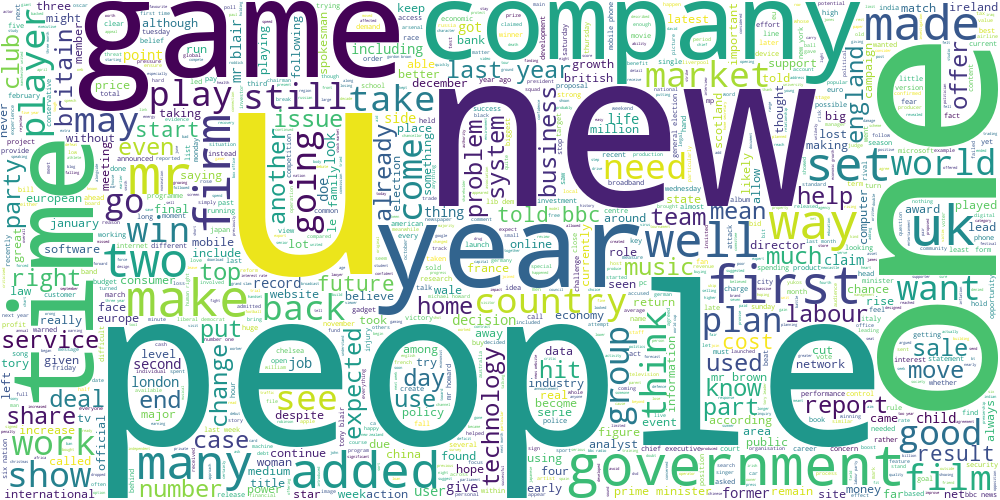

In [13]:
draw_wordcloud(data.text)

**Задание 2.1 (1 балл).** Обучите алгоритм K-Means на tf-idf представлениях текстов. При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова, а также воздержитесь от использования N-грамм. Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8). Постройте облака тегов для текстов из разных кластеров. Получились ли темы интерпретируемыми? Попробуйте озаглавить каждую тему.

**Ответ:** Темы получилить очень даже интерпретируемы)

In [152]:
data.text

0       ad sale boost time warner profit quarterly pro...
1       dollar gain greenspan speech dollar hit highes...
2       yukos unit buyer face loan claim owner embattl...
3       high fuel price hit ba profit british airway b...
4       pernod takeover talk lift domecq share uk drin...
                              ...                        
2220    bt program beat dialler scam bt introducing tw...
2221    spam tempt net shopper computer user across wo...
2222    careful code new european directive could put ...
2223    u cyber security chief resigns man making sure...
2224    losing online gaming online role playing game ...
Name: text, Length: 2225, dtype: object

In [153]:
from sklearn.feature_extraction.text import TfidfVectorizer
corpus = data.text
vectorizer = TfidfVectorizer(min_df = 0.01, )
X = vectorizer.fit_transform(corpus)
vectorizer.get_feature_names_out() 


print(X.shape)

(2225, 2624)


In [154]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=8, random_state=0).fit(X)
kmeans.labels_

array([6, 6, 6, ..., 0, 0, 0], dtype=int32)

In [155]:
kmeans.labels_.shape

(2225,)

In [156]:
data

,category,filename,title,content,raw_text,text,cluster_kmeans
0,business,001.txt,Ad sales boost Time Warner profit,Quarterly profits at US media giant TimeWarne...,Ad sales boost Time Warner profit Quarterly pr...,ad sale boost time warner profit quarterly pro...,6
1,business,002.txt,Dollar gains on Greenspan speech,The dollar has hit its highest level against ...,Dollar gains on Greenspan speech The dollar ha...,dollar gain greenspan speech dollar hit highes...,6
2,business,003.txt,Yukos unit buyer faces loan claim,The owners of embattled Russian oil giant Yuk...,Yukos unit buyer faces loan claim The owners o...,yukos unit buyer face loan claim owner embattl...,6
3,business,004.txt,High fuel prices hit BA's profits,British Airways has blamed high fuel prices f...,High fuel prices hit BA's profits British Airw...,high fuel price hit ba profit british airway b...,6
4,business,005.txt,Pernod takeover talk lifts Domecq,Shares in UK drinks and food firm Allied Dome...,Pernod takeover talk lifts Domecq Shares in UK...,pernod takeover talk lift domecq share uk drin...,6
...,...,...,...,...,...,...,...
2220,tech,397.txt,BT program to beat dialler scams,BT is introducing two initiatives to help bea...,BT program to beat dialler scams BT is introdu...,bt program beat dialler scam bt introducing tw...,0
2221,tech,398.txt,Spam e-mails tempt net shoppers,Computer users across the world continue to i...,Spam e-mails tempt net shoppers Computer users...,spam tempt net shopper computer user across wo...,0
2222,tech,399.txt,Be careful how you code,A new European directive could put software w...,Be careful how you code A new European directi...,careful code new european directive could put ...,0
2223,tech,400.txt,US cyber security chief resigns,The man making sure US computer networks are ...,US cyber security chief resigns The man making...,u cyber security chief resigns man making sure...,0


In [157]:
data['cluster_kmeans'] = kmeans.labels_.tolist()

In [158]:
data

,category,filename,title,content,raw_text,text,cluster_kmeans
0,business,001.txt,Ad sales boost Time Warner profit,Quarterly profits at US media giant TimeWarne...,Ad sales boost Time Warner profit Quarterly pr...,ad sale boost time warner profit quarterly pro...,6
1,business,002.txt,Dollar gains on Greenspan speech,The dollar has hit its highest level against ...,Dollar gains on Greenspan speech The dollar ha...,dollar gain greenspan speech dollar hit highes...,6
2,business,003.txt,Yukos unit buyer faces loan claim,The owners of embattled Russian oil giant Yuk...,Yukos unit buyer faces loan claim The owners o...,yukos unit buyer face loan claim owner embattl...,6
3,business,004.txt,High fuel prices hit BA's profits,British Airways has blamed high fuel prices f...,High fuel prices hit BA's profits British Airw...,high fuel price hit ba profit british airway b...,6
4,business,005.txt,Pernod takeover talk lifts Domecq,Shares in UK drinks and food firm Allied Dome...,Pernod takeover talk lifts Domecq Shares in UK...,pernod takeover talk lift domecq share uk drin...,6
...,...,...,...,...,...,...,...
2220,tech,397.txt,BT program to beat dialler scams,BT is introducing two initiatives to help bea...,BT program to beat dialler scams BT is introdu...,bt program beat dialler scam bt introducing tw...,0
2221,tech,398.txt,Spam e-mails tempt net shoppers,Computer users across the world continue to i...,Spam e-mails tempt net shoppers Computer users...,spam tempt net shopper computer user across wo...,0
2222,tech,399.txt,Be careful how you code,A new European directive could put software w...,Be careful how you code A new European directi...,careful code new european directive could put ...,0
2223,tech,400.txt,US cyber security chief resigns,The man making sure US computer networks are ...,US cyber security chief resigns The man making...,u cyber security chief resigns man making sure...,0


# Politics

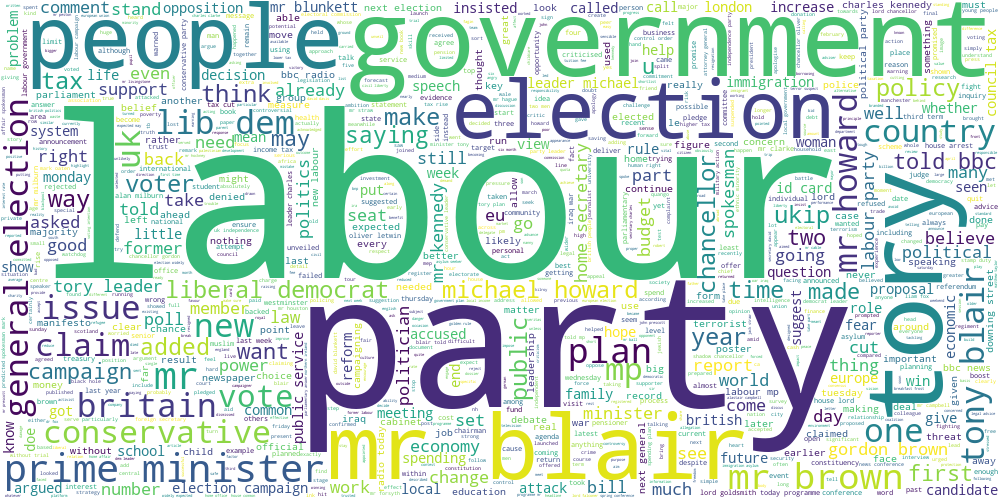

In [608]:
draw_wordcloud(data.loc[data['cluster_kmeans'] ==1].text)


# Entertainment

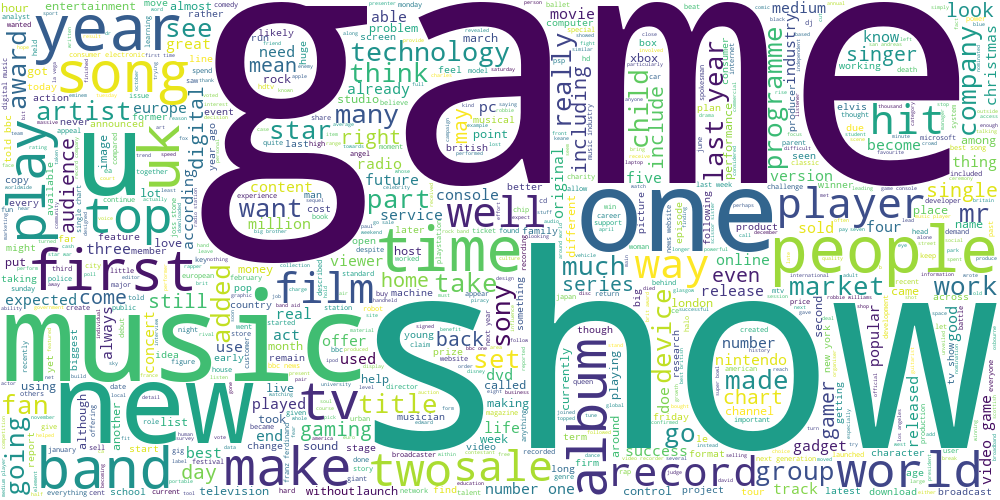

In [609]:
draw_wordcloud(data.loc[data['cluster_kmeans'] ==2].text)

# Economics

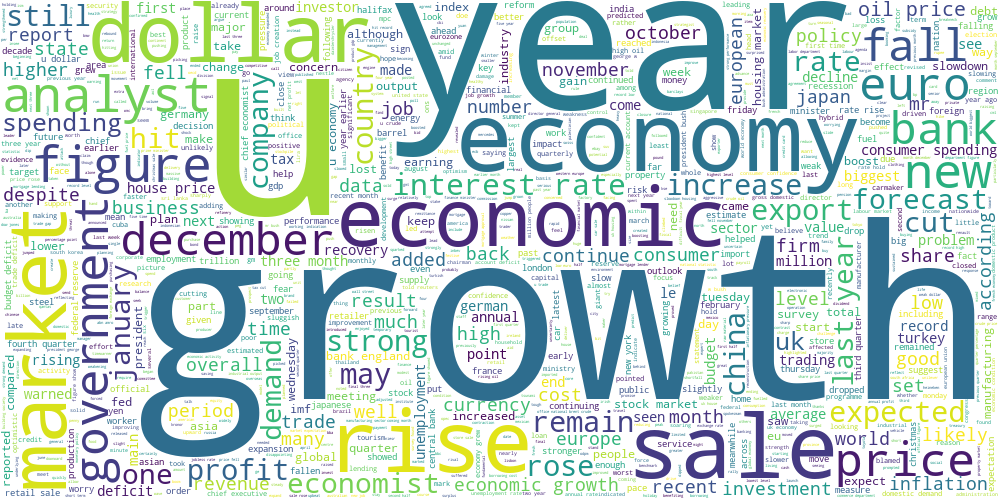

In [610]:
draw_wordcloud(data.loc[data['cluster_kmeans'] ==3].text)

# Film industry

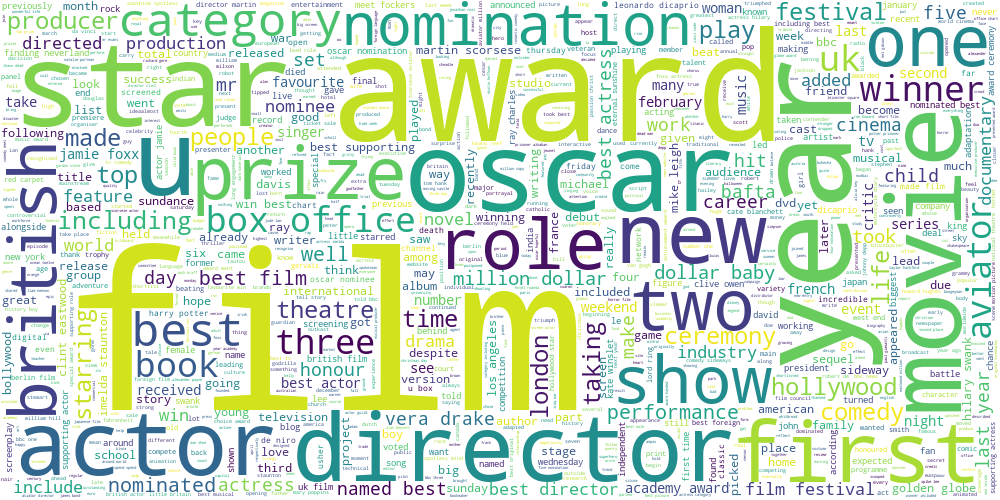

In [611]:
draw_wordcloud(data.loc[data['cluster_kmeans'] ==4].text)

# Business

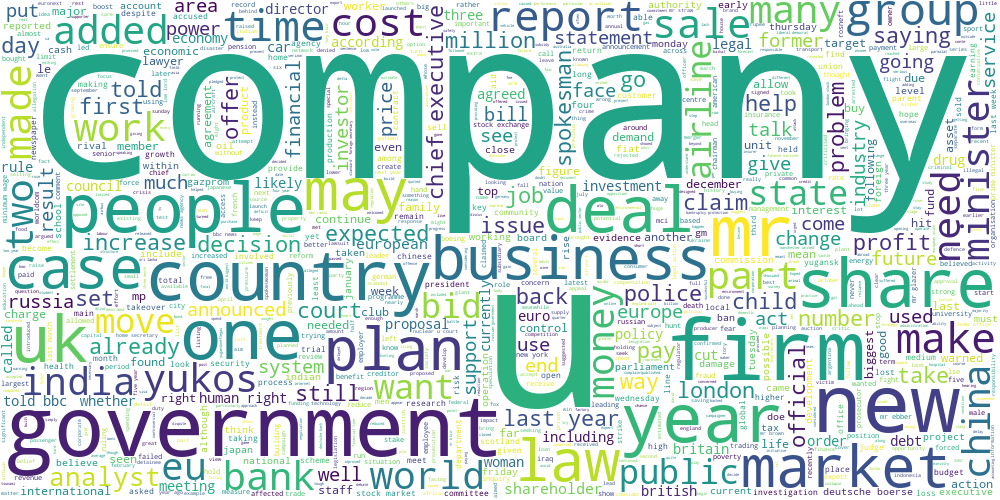

In [612]:
draw_wordcloud(data.loc[data['cluster_kmeans'] ==5].text)

# Internet

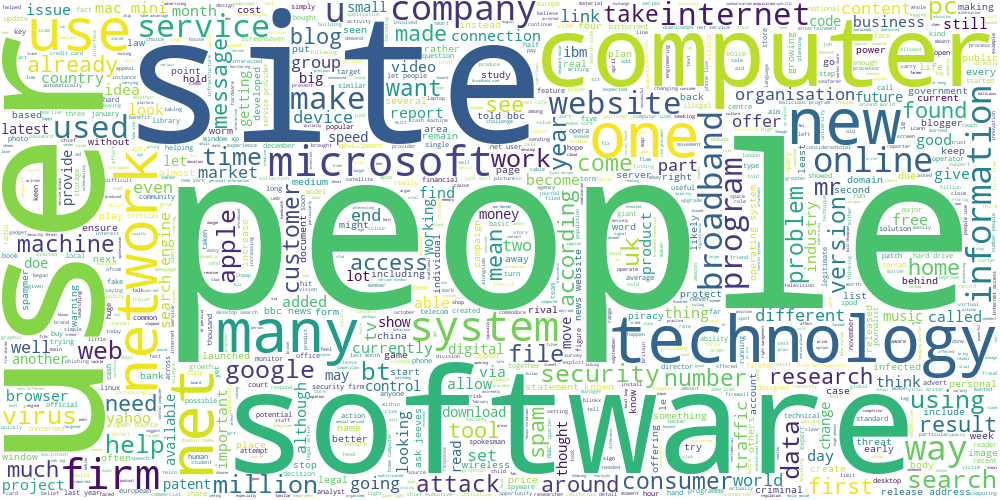

In [613]:
draw_wordcloud(data.loc[data['cluster_kmeans'] ==6].text)

# Gadgets 

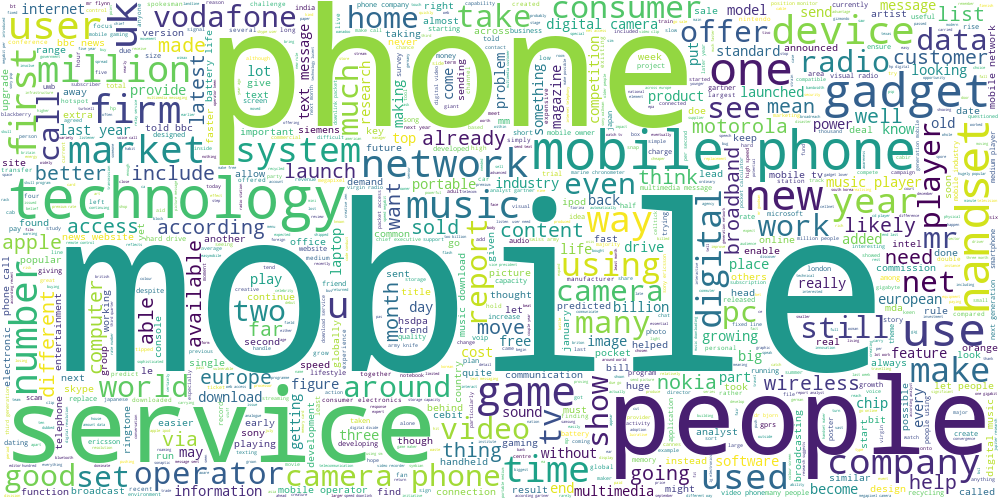

In [614]:
draw_wordcloud(data.loc[data['cluster_kmeans'] ==7].text)

# Sport

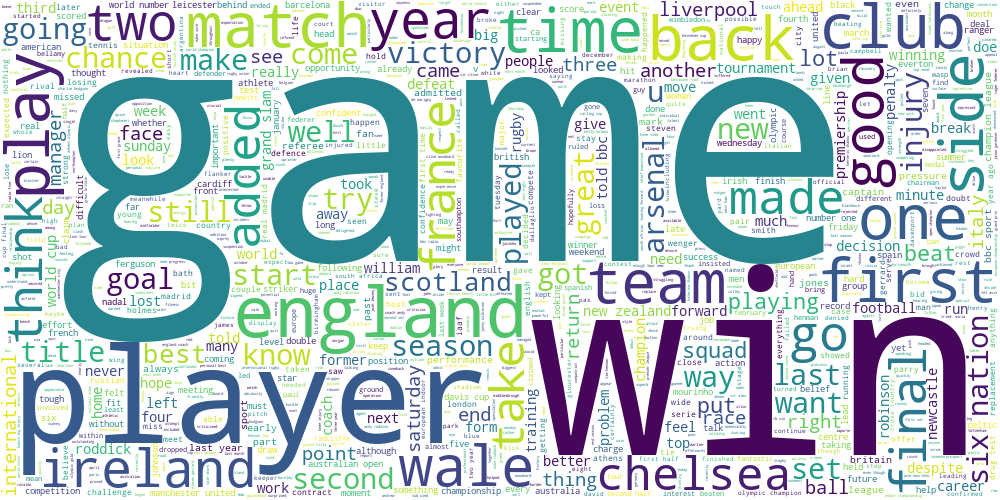

In [615]:
draw_wordcloud(data.loc[data['cluster_kmeans'] ==0].text)

Темы получились хорошо интерпретируемы

**Задание 2.2 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера. Попробуйте взять центры кластеров и посмотреть на слова, для которых значения соответствующих им признаков максимальны. Согласуются ли полученные слова с облаками тегов из прошлого задания?

**Ответ:**

Да, темы согласуются с прошлым заданием.

In [159]:
centers = kmeans.cluster_centers_

In [160]:
word_centers = vectorizer.inverse_transform(centers)
j = 0
for i in centers:
    vectr = i[i>0]
    thresh = sorted(vectr)[-5]
    mask = vectr>thresh
    print(word_centers[j][mask])
    j+=1

['mobile' 'people' 'phone' 'technology']
['election' 'labour' 'mr' 'party']
['champion' 'open' 'seed' 'world']
['arsenal' 'chelsea' 'club' 'game']
['england' 'ireland' 'rugby' 'wale']
['album' 'band' 'music' 'show']
['company' 'firm' 'market' 'year']
['award' 'best' 'film' 'oscar']


**Задание 2.3 (1.5 балла).** В первой части мы сравнили три разных алгоритма кластеризации на географических данных. Проделаем то же самое для текстовых данных (в качестве признакого описания снова используем tf-idf). Получите три разбиения на кластеры с помощью алгоритмов K-Means, DBSCAN и спектральной кластеризации (на этот раз воспользуйтесь реализацией из `sklearn`). Для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров, подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров.

Далее, обучите двухмерные t-SNE представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом. Лучше всего расположить визуализации на одном графике на трех разных сабплотах. Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [191]:
import numpy as np

In [203]:
# для бонуса

def bcubed_dic(ind, y):
    d = {}
    for i in range(len(ind)): 
        d[ind[i]] = set([y[i]])
    return d

In [163]:
centers.max(axis = 1).shape

(8,)

In [164]:
kmeans = KMeans(n_clusters=8, random_state=0).fit(X)
kmeans.labels_

/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([6, 6, 6, ..., 0, 0, 0], dtype=int32)

In [165]:
from sklearn.cluster import DBSCAN
clustering_dbscan = DBSCAN(eps = 1.16).fit(X)

In [166]:
len(set(clustering_dbscan.labels_))

8

In [169]:
from sklearn.cluster import SpectralClustering

In [170]:
clustering_spec = SpectralClustering(n_clusters=8,
         random_state=0).fit(X)
clustering_spec.labels_


array([0, 0, 3, ..., 7, 7, 1], dtype=int32)

In [172]:
from sklearn.manifold import TSNE
X_embedded = TSNE(n_components = 2, init="random").fit_transform(X)
X_embedded.shape

(2225, 2)

In [173]:
X_embedded

array([[-30.646713 ,   9.226412 ],
       [-55.212757 , -14.034519 ],
       [-44.92413  ,  -7.0598655],
       ...,
       [-30.89473  ,  23.823803 ],
       [-29.303608 ,  37.406857 ],
       [  3.8465755,  10.593789 ]], dtype=float32)

In [174]:
X_embedded[:, 0]

array([-30.646713 , -55.212757 , -44.92413  , ..., -30.89473  ,
       -29.303608 ,   3.8465755], dtype=float32)

In [208]:
ldict = bcubed_dic(data.index, data.category)
cdict = bcubed_dic(data.index, kmeans.labels_)
precision = bcubed.precision(cdict, ldict)
recall = bcubed.recall(cdict, ldict)
fscore = bcubed.fscore(precision, recall)
precision, recall, fscore

(0.8698583967468557, 0.64232581931009, 0.7389741295291298)

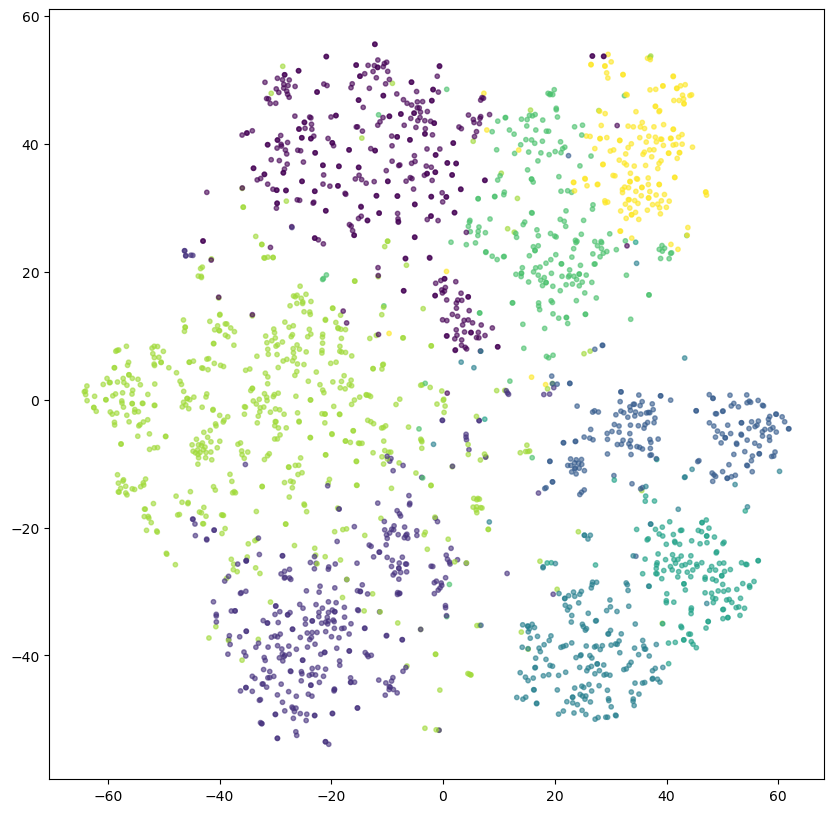

In [175]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10,10))
plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c = kmeans.labels_, alpha = 0.6, s=10)

In [209]:
ldict = bcubed_dic(data.index, data.category)
cdict = bcubed_dic(data.index, clustering_dbscan.labels_)
precision = bcubed.precision(cdict, ldict)
recall = bcubed.recall(cdict, ldict)
fscore = bcubed.fscore(precision, recall)
precision, recall, fscore

(0.2122826928153665, 0.5740201716470025, 0.30994303410272345)

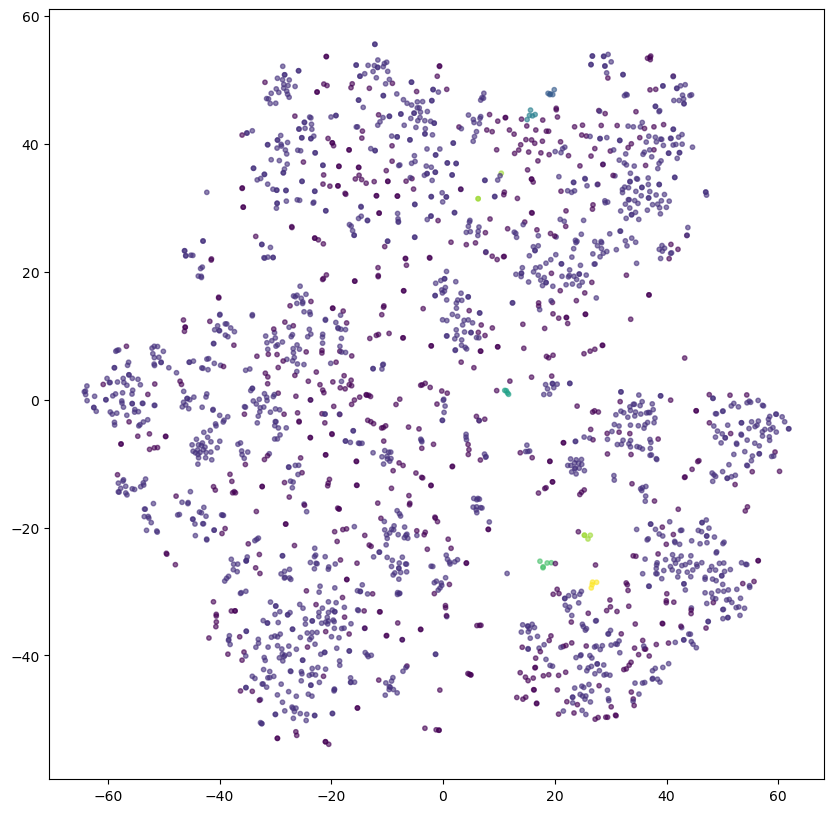

In [176]:
plt.figure(figsize=(10,10))
plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c = clustering_dbscan.labels_, alpha = 0.6, s=10)

In [210]:
ldict = bcubed_dic(data.index, data.category)
cdict = bcubed_dic(data.index, clustering_spec.labels_)
precision = bcubed.precision(cdict, ldict)
recall = bcubed.recall(cdict, ldict)
fscore = bcubed.fscore(precision, recall)
precision, recall, fscore

(0.6475872791746661, 0.5007983175094011, 0.5648113678673815)

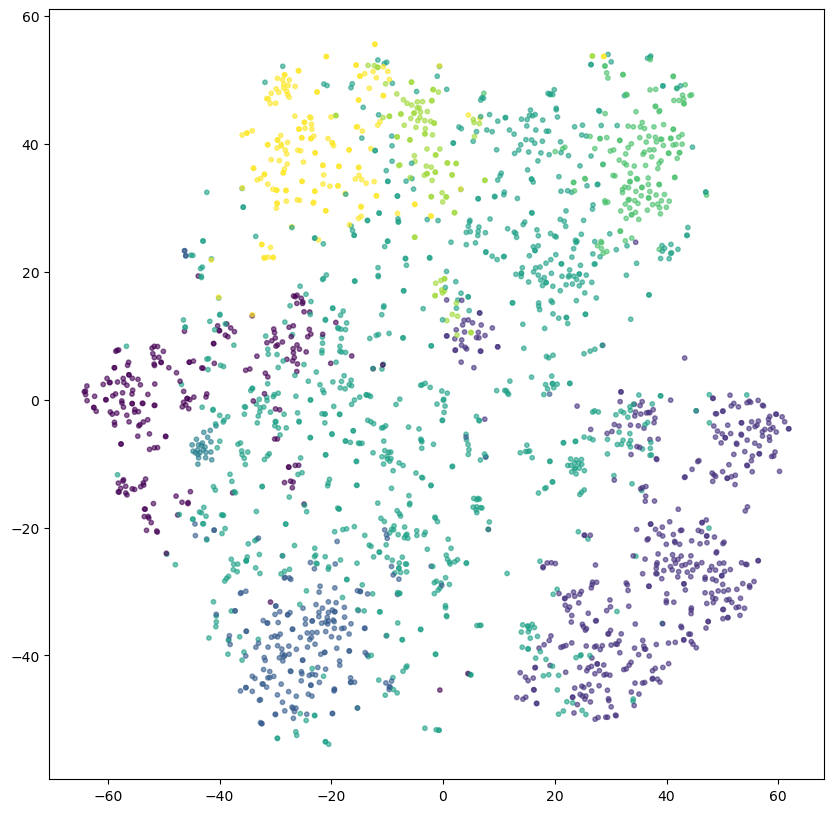

In [177]:
plt.figure(figsize=(10,10))
plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c = clustering_spec.labels_, alpha = 0.6, s=10)

Прокомментируйте получившиеся результаты. Какой баланс кластеров получился у разных методов? Соотносятся ли визуализации для текстов с визуализациями для географических данных?

**Ответ:**

Очевидно, что лучше всего себя показали kmeans и спектральная кластеризация, у них хорошее соотношение кластеров. А вот в dbscan очень много одного класса, а остальные очень маленькие, как будто он сконцентрировался только на поиске выбросов. С визуализацией географических данных очень похож kmeans, остальные продемонстрировали себя все-же чуть по другому, разве что можно тоже заметить, что  спектральная не сильно скругляет и находит очень протяженные кластеры по всей координатной плоскости. 

**Задание 2.4 (1.5 балла).** Обучите модель латентного размещения Дирихле. Не забудьте, что она работает с мешком слов, а не с tf-idf признаками. Придумайте, как превратить распределение тем для текста в номер его кластера. Возьмите параметр `n_components` в 2-3 раза больше, чем число кластеров для K-Means. Получились ли темы более узкими от такого нововведения? Постройте облака тегов для нескольких наиболее удачных тем.

**Ответ:**

In [211]:
from sklearn.feature_extraction.text import CountVectorizer

In [213]:
countvec = CountVectorizer()
cdf = countvec.fit_transform(data.text)
bow = pd.DataFrame(cdf.toarray(), columns = countvec.get_feature_names_out())
bow

,aa,aaa,aac,aadc,aaliyah,aaltra,aamir,aara,aarhus,aaron,...,zoom,zooropa,zornotza,zorro,zubair,zuluaga,zurich,zutons,zvonareva,zvyagintsev
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2220,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2221,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2222,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2223,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [218]:
from sklearn.decomposition import LatentDirichletAllocation
lda = LatentDirichletAllocation(n_components=16,
     random_state=0)
mat = lda.fit_transform(bow)

In [219]:
data['cluster_lda'] = np.argmax(mat, axis =1)

In [220]:
data

,category,filename,title,content,raw_text,text,cluster_kmeans,cluster_lda
0,business,001.txt,Ad sales boost Time Warner profit,Quarterly profits at US media giant TimeWarne...,Ad sales boost Time Warner profit Quarterly pr...,ad sale boost time warner profit quarterly pro...,6,11
1,business,002.txt,Dollar gains on Greenspan speech,The dollar has hit its highest level against ...,Dollar gains on Greenspan speech The dollar ha...,dollar gain greenspan speech dollar hit highes...,6,11
2,business,003.txt,Yukos unit buyer faces loan claim,The owners of embattled Russian oil giant Yuk...,Yukos unit buyer faces loan claim The owners o...,yukos unit buyer face loan claim owner embattl...,6,10
3,business,004.txt,High fuel prices hit BA's profits,British Airways has blamed high fuel prices f...,High fuel prices hit BA's profits British Airw...,high fuel price hit ba profit british airway b...,6,11
4,business,005.txt,Pernod takeover talk lifts Domecq,Shares in UK drinks and food firm Allied Dome...,Pernod takeover talk lifts Domecq Shares in UK...,pernod takeover talk lift domecq share uk drin...,6,9
...,...,...,...,...,...,...,...,...
2220,tech,397.txt,BT program to beat dialler scams,BT is introducing two initiatives to help bea...,BT program to beat dialler scams BT is introdu...,bt program beat dialler scam bt introducing tw...,0,2
2221,tech,398.txt,Spam e-mails tempt net shoppers,Computer users across the world continue to i...,Spam e-mails tempt net shoppers Computer users...,spam tempt net shopper computer user across wo...,0,2
2222,tech,399.txt,Be careful how you code,A new European directive could put software w...,Be careful how you code A new European directi...,careful code new european directive could put ...,0,2
2223,tech,400.txt,US cyber security chief resigns,The man making sure US computer networks are ...,US cyber security chief resigns The man making...,u cyber security chief resigns man making sure...,0,2


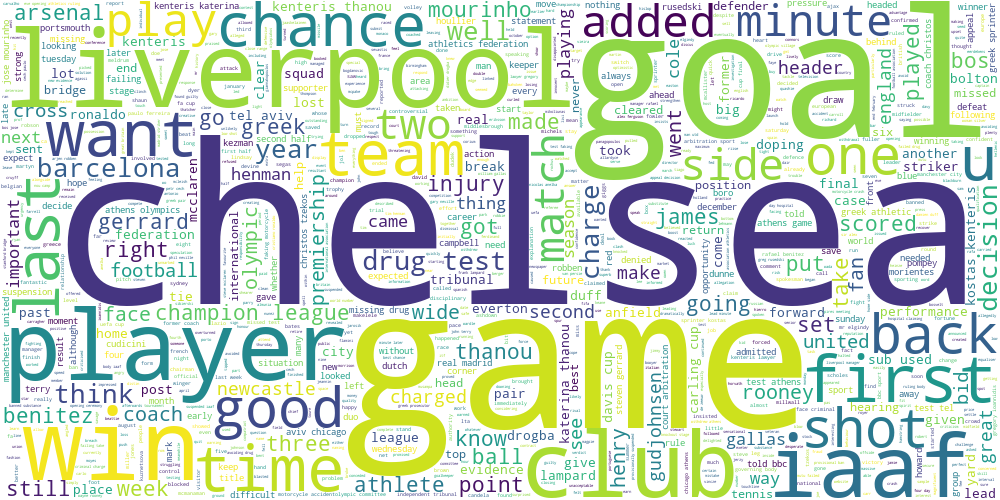

In [231]:
draw_wordcloud(data.loc[data['cluster_lda'] ==0].text)

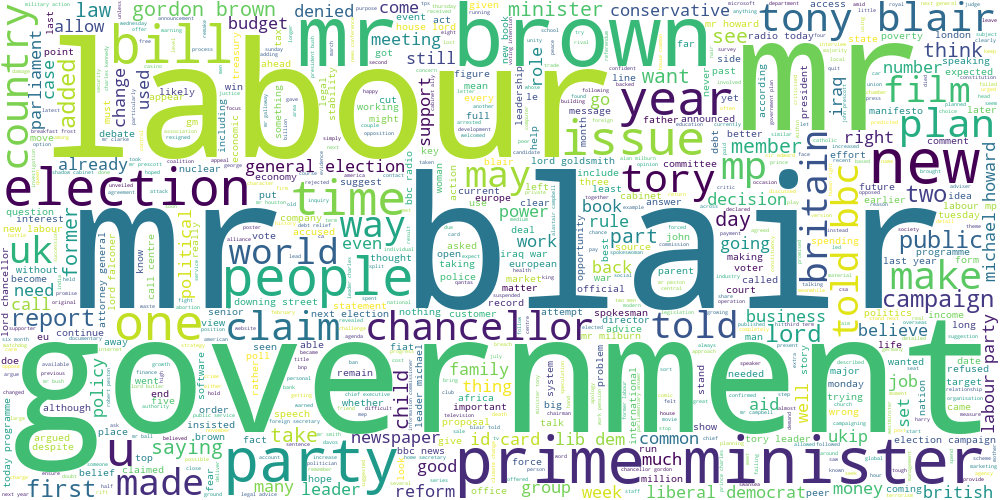

In [222]:
draw_wordcloud(data.loc[data['cluster_lda'] ==1].text)

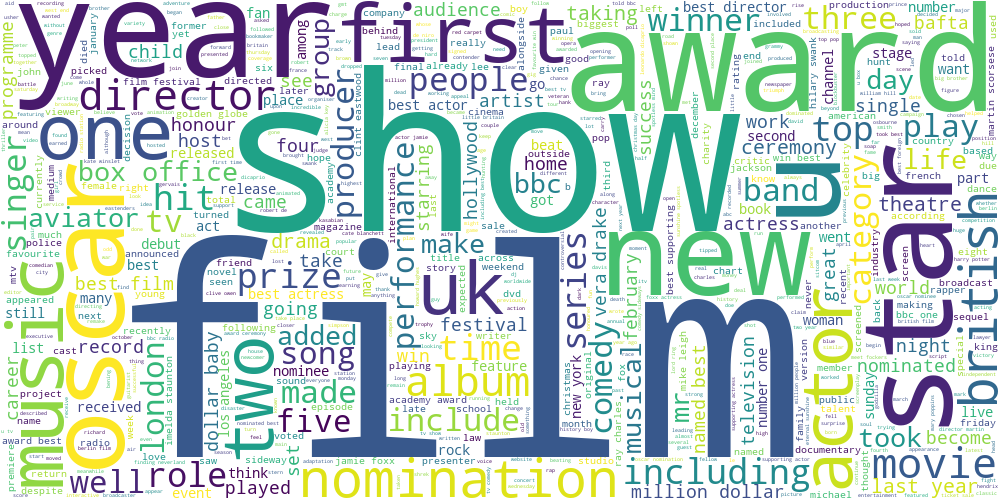

In [226]:
draw_wordcloud(data.loc[data['cluster_lda'] ==5].text)

https://scikit-learn.org/stable/auto_examples/applications/plot_topics_extraction_with_nmf_lda.html

In [227]:
n_top_words = 10
def plot_top_words(model, feature_names, n_top_words, title):
    fig, axes = plt.subplots(4, 4, figsize=(40, 15), sharex=True)
    axes = axes.flatten()
    for topic_idx, topic in enumerate(model.components_):
        top_features_ind = topic.argsort()[: -n_top_words - 1 : -1]
        top_features = [feature_names[i] for i in top_features_ind]
        weights = topic[top_features_ind]

        ax = axes[topic_idx]
        ax.barh(top_features, weights, height=0.7)
        ax.set_title(f"Topic {topic_idx +1}", fontdict={"fontsize": 30})
        ax.invert_yaxis()
        ax.tick_params(axis="both", which="major", labelsize=20)
        for i in "top right left".split():
            ax.spines[i].set_visible(False)
        fig.suptitle(title, fontsize=40)

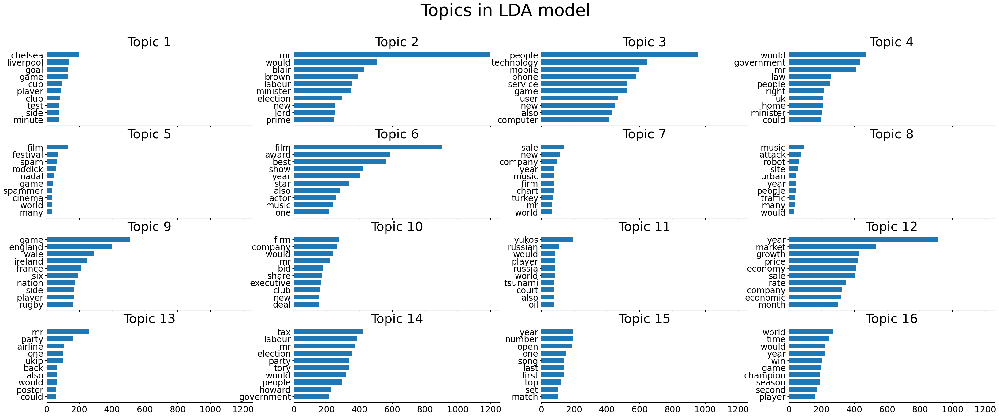

In [229]:
tf_feature_names = countvec.get_feature_names_out()
plot_top_words(lda, tf_feature_names, n_top_words, "Topics in LDA model")

КАк мне кажется, темы получились более узкими, но при этом повторяющимися. 

## Часть 3. Transfer learning для задачи классификации текстов

**Задание 3.1 (0.5 балла).** Вспомним, что у нас есть разметка для тематик статей. Попробуем обучить классификатор поверх unsupervised-представлений для текстов. Рассмотрите три модели:

* Логистическая регрессия на tf-idf признаках
* K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров
* Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

Разделите выборку на обучающую и тестовую, замерьте accuracy на обоих выборках для всех трех моделей. Параметры всех моделей возьмите равными значениям по умолчанию.

In [27]:
data.text

0       ad sale boost time warner profit quarterly pro...
1       dollar gain greenspan speech dollar hit highes...
2       yukos unit buyer face loan claim owner embattl...
3       high fuel price hit ba profit british airway b...
4       pernod takeover talk lift domecq share uk drin...
                              ...                        
2220    bt program beat dialler scam bt introducing tw...
2221    spam tempt net shopper computer user across wo...
2222    careful code new european directive could put ...
2223    u cyber security chief resigns man making sure...
2224    losing online gaming online role playing game ...
Name: text, Length: 2225, dtype: object

In [131]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
X_train, X_test, y_train, y_test = train_test_split(data.text, data['category'], test_size=0.33, random_state=42)

In [132]:
from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer(min_df = 0.01)
X_train_tf= vectorizer.fit_transform(X_train)
X_test_tf = vectorizer.transform(X_test)


In [133]:
clf = LogisticRegression(random_state=0).fit(X_train_tf, y_train)
y_pred_train = clf.predict(X_train_tf)
y_pred = clf.predict(X_test_tf)
print('accuracy на трейне',accuracy_score(y_pred_train, y_train),  'accuracy на тесте', accuracy_score(y_pred, y_test))

accuracy на трейне 0.9953020134228188 accuracy на тесте 0.9768707482993197


In [147]:
# для бонуса

def bcubed_dic(ind, y):
    d = {}
    for i in range(len(ind)): 
        d[ind[i]] = y[i]
    return d
            

In [39]:
kmeans = KMeans(n_clusters=8, random_state=0).fit(X_train_tf)
X_train_centers = kmeans.transform(X_train_tf)
X_test_centers = kmeans.transform(X_test_tf)

/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [40]:
clf = LogisticRegression(random_state=0).fit(X_train_centers, y_train)
y_pred_train = clf.predict(X_train_centers)
y_pred = clf.predict(X_test_centers)
print('accuracy на трейне',accuracy_score(y_pred_train, y_train),  'accuracy на тесте', accuracy_score(y_pred, y_test))

accuracy на трейне 0.9033557046979865 accuracy на тесте 0.9006802721088435


/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [43]:
from sklearn.feature_extraction.text import CountVectorizer
countvec = CountVectorizer()
train_cdf = countvec.fit_transform(X_train)
test_cdf = countvec.transform(X_test)
X_train_bow = pd.DataFrame(train_cdf.toarray(), columns = countvec.get_feature_names_out())
X_test_bow = pd.DataFrame(test_cdf.toarray(), columns = countvec.get_feature_names_out())
X_train_bow, X_test_bow 

(      aa  aaa  aac  aadc  aaliyah  aaltra  aara  aaron  abandon  abandoned  \
 0      0    0    0     0        0       0     0      0        0          0   
 1      0    0    0     0        0       0     0      0        0          0   
 2      0    0    0     0        0       0     0      0        0          0   
 3      0    0    0     0        0       0     0      0        0          0   
 4      0    0    0     0        0       0     0      0        0          0   
 ...   ..  ...  ...   ...      ...     ...   ...    ...      ...        ...   
 1485   0    0    0     0        0       0     0      0        0          0   
 1486   0    0    0     0        0       0     0      0        0          0   
 1487   0    0    0     0        0       0     0      0        0          0   
 1488   0    0    0     0        0       0     0      0        0          1   
 1489   0    0    0     0        0       0     0      0        0          0   
 
       ...  zombie  zone  zonealarm  zoom  zornotz

In [44]:
from sklearn.decomposition import LatentDirichletAllocation
lda = LatentDirichletAllocation(n_components=6,
     random_state=0)
X_train_lda = lda.fit_transform(X_train_bow)
X_test_lda = lda.transform(X_test_bow)

array([[7.99192927e-04, 2.22736127e-02, 6.19791698e-03, 7.97681991e-04,
        1.55263855e-02, 9.54405210e-01],
       [7.96679264e-04, 1.24332699e-01, 7.11588521e-01, 7.93443675e-04,
        4.44276372e-02, 1.18061020e-01],
       [2.97596312e-01, 1.80769427e-02, 8.29063428e-04, 3.85758593e-02,
        6.44082727e-01, 8.39095839e-04],
       ...,
       [4.85286588e-02, 1.37076702e-01, 1.25339108e-02, 2.05318994e-02,
        1.20465698e-01, 6.60863130e-01],
       [1.54278359e-03, 2.76914395e-02, 4.36301299e-01, 1.54824727e-03,
        1.55004545e-03, 5.31366185e-01],
       [2.90498938e-01, 4.00341595e-04, 4.00042949e-04, 4.00649744e-04,
        7.07899131e-01, 4.00896968e-04]])

In [46]:
clf = LogisticRegression(random_state=0).fit(X_train_lda, y_train)
y_pred_train = clf.predict(X_train_lda)
y_pred = clf.predict(X_test_lda)
print('accuracy на трейне',accuracy_score(y_pred_train, y_train),  'accuracy на тесте', accuracy_score(y_pred, y_test))

accuracy на трейне 0.7758389261744967 accuracy на тесте 0.8163265306122449


In [ ]:
kmeans = KMeans(n_clusters=8, random_state=0).fit(X_train_tf)
X_train_centers = kmeans.transform(X_train_tf)
X_test_centers = kmeans.transform(X_test_tf)

У какой модели получилось лучшее качество? С чем это связано?

**Ответ:**

У обычной логистической регрессии получилось самое хорошее качество) Потому что логитическая регрессия это обучение с учителем, она учится зная реальное распределение кластеров на трейне, а остальные модели не знают это распределение при кластеризации. 

**Задание 3.2 (1.5 балла).** Теперь просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 5:65:30. Будем называть части, соответственно, размеченный трейн, неразмеченный трейн и валидация.

Все unsupervised-алгоритмы (векторайзеры и алгоритмы кластеризации) запускайте на всем трейне целиком (размеченном и неразмеченном, суммарно 70%), а итоговый классификатор обучайте только на размеченном трейне (5%). Подберите гиперпараметры моделей по качеству на валидации (30%), а затем оцените качество на тестовой выборке (которая осталась от прошлого задания). Не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации. 

In [91]:
X_train2, X_val, y_train2, y_val = train_test_split(X_train, y_train, test_size=0.3, random_state=42)
X_mark, X_unmark, y_mark, y_unmark = train_test_split(X_train2, y_train2, test_size=0.929, random_state=42)


In [74]:
from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer(min_df = 0.01)
X_train2_tf= vectorizer.fit_transform(X_train2)
X_mark_tf = vectorizer.transform(X_mark)
X_val_tf = vectorizer.transform(X_val)
X_test_tf = vectorizer.transform(X_test)

In [109]:
clf = LogisticRegression(random_state=0).fit(X_train2_tf, y_train2)
y_pred_mark = clf.predict(X_mark_tf)
y_pred = clf.predict(X_test_tf)
print('accuracy на размеченной',accuracy_score(y_pred_mark, y_mark),  'accuracy на тесте', accuracy_score(y_pred, y_test))


accuracy на размеченной 1.0 accuracy на тесте 0.9714285714285714


In [76]:
clust = [10, 50, 100, 200, 500, 700, 1000, 1500]

In [78]:
for i in clust:
    kmeans = KMeans(n_clusters=i, random_state=0).fit(X_train2_tf)
    X_mark_centers = kmeans.transform(X_mark_tf)
    X_val_centers = kmeans.transform(X_val_tf)
    X_test_centers = kmeans.transform(X_test_tf)
    clf = LogisticRegression(random_state=0).fit(X_mark_centers, y_mark)
    y_pred_mark = clf.predict(X_mark_centers)
    y_pred_val = clf.predict(X_val_centers)
    print('число кластеров:', i, 'accuracy на размеченной',accuracy_score(y_pred_mark, y_mark),  'accuracy на валидации', accuracy_score(y_pred_val, y_val))

/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


число кластеров: 10 accuracy на размеченной 0.3783783783783784 accuracy на валидации 0.2796420581655481


/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to s

число кластеров: 50 accuracy на размеченной 0.7702702702702703 accuracy на валидации 0.6353467561521253


/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


число кластеров: 100 accuracy на размеченной 0.918918918918919 accuracy на валидации 0.7762863534675615


/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


число кластеров: 200 accuracy на размеченной 0.9864864864864865 accuracy на валидации 0.8903803131991052


/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


число кластеров: 500 accuracy на размеченной 1.0 accuracy на валидации 0.9172259507829977


/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


число кластеров: 700 accuracy на размеченной 1.0 accuracy на валидации 0.912751677852349
число кластеров: 1000 accuracy на размеченной 1.0 accuracy на валидации 0.9239373601789709


/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


ValueError: n_samples=1043 should be >= n_clusters=1500.

In [81]:
kmeans = KMeans(n_clusters=1000, random_state=0).fit(X_train2_tf)
X_mark_centers = kmeans.transform(X_mark_tf)
X_val_centers = kmeans.transform(X_val_tf)
X_test_centers = kmeans.transform(X_test_tf)
X_val_centers = kmeans.transform(X_val_tf)
clf = LogisticRegression(random_state=0).fit(X_mark_centers, y_mark)
y_pred_mark = clf.predict(X_mark_centers)
y_pred_val = clf.predict(X_val_centers)
y_pred_test = clf.predict(X_test_centers)
print('число кластеров:', 1000, 'accuracy на размеченной',accuracy_score(y_pred_mark, y_mark),  'accuracy на валидации', accuracy_score(y_pred_val, y_val), 'accuracy на тесте', accuracy_score(y_pred_test, y_test))
      
      

/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


число кластеров: 1000 accuracy на размеченной 1.0 accuracy на валидации 0.9239373601789709 accuracy на тесте 0.9306122448979591


/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [117]:
from sklearn.feature_extraction.text import CountVectorizer
countvec = CountVectorizer()
X_train2_cdf = countvec.fit_transform(X_train2)
X_mark_cdf = countvec.transform(X_mark)
X_val_cdf = countvec.transform(X_val)
X_test_cdf = countvec.transform(X_test)
X_mark_bow = pd.DataFrame(X_mark_cdf.toarray(), columns = countvec.get_feature_names_out())
X_val_bow = pd.DataFrame(X_val_cdf.toarray(), columns = countvec.get_feature_names_out())
X_test_bow = pd.DataFrame(X_test_cdf.toarray(), columns = countvec.get_feature_names_out())
X_train2_bow = pd.DataFrame(X_train2_cdf.toarray(), columns = countvec.get_feature_names_out())

In [118]:
for i in [10, 50, 100, 200, 500, 700, 1000]:
    lda = LatentDirichletAllocation(n_components=i,
         random_state=0)
    X_train2_lda = lda.fit(X_train2_bow)
    X_mark_lda = lda.transform(X_mark_bow)
    X_val_lda = lda.transform(X_val_bow)
    clf = LogisticRegression(random_state=0).fit(X_mark_lda, y_mark)
    y_pred_mark = clf.predict(X_mark_lda)
    y_pred_val = clf.predict(X_val_lda)
    print('число кластеров:', i, 'accuracy на размеченной',accuracy_score(y_pred_mark, y_mark),  'accuracy на валидации', accuracy_score(y_pred_val, y_val))

число кластеров: 10 accuracy на размеченной 0.6486486486486487 accuracy на валидации 0.756152125279642
число кластеров: 50 accuracy на размеченной 0.9054054054054054 accuracy на валидации 0.785234899328859
число кластеров: 100 accuracy на размеченной 0.9324324324324325 accuracy на валидации 0.7002237136465325
число кластеров: 200 accuracy на размеченной 0.9324324324324325 accuracy на валидации 0.5033557046979866
число кластеров: 500 accuracy на размеченной 0.9324324324324325 accuracy на валидации 0.28859060402684567
число кластеров: 700 accuracy на размеченной 0.9459459459459459 accuracy на валидации 0.2214765100671141
число кластеров: 1000 accuracy на размеченной 0.9864864864864865 accuracy на валидации 0.23042505592841164


In [122]:
lda = LatentDirichletAllocation(n_components=50,
      random_state=0)
lda.fit(X_train2_bow)
X_mark_lda = lda.transform(X_mark_bow)
X_val_lda = lda.transform(X_val_bow)
X_test_lda = lda.transform(X_test_bow)
clf = LogisticRegression(random_state=0).fit(X_mark_lda, y_mark)
y_pred_mark = clf.predict(X_mark_lda)
y_pred_val = clf.predict(X_val_lda)
y_pred_test = clf.predict(X_test_lda)
print('число кластеров:', 50, 'accuracy на размеченной',accuracy_score(y_pred_mark, y_mark),  'accuracy на валидации', accuracy_score(y_pred_val, y_val), 'accuracy на тесте', accuracy_score(y_pred_test, y_test))


число кластеров: 50 accuracy на размеченной 0.9054054054054054 accuracy на валидации 0.785234899328859 accuracy на тесте 0.7605442176870748


Как изменились результаты по сравнению с обучением на полной разметке? Сделайте выводы.

**Ответ:**

На самом деле не сильно то и изменились резлуьтаты, где-то чуть подрос, где то чуть чуть упало, но не значетельно. сотые доли. Но, конечно, разбитие на дополнительную валидационную выборку это всегда полезно, потому что это позволяет правильно подбирать гиперпараметры, не подглядывая в тест .

## Бонус

**Задание 4 (1 балл)**. Разберитесь с semi-supervised методами, которые реализованы в `sklearn` и примените их к заданию 3.2. Получилось ли добиться лучшего качества? Сделайте выводы.

In [112]:
y_train2_1

1615       -1
1662    sport
503        -1
1606       -1
1182       -1
        ...  
1705       -1
1438       -1
1973       -1
1528       -1
920        -1
Name: category, Length: 1043, dtype: object

In [86]:
from sklearn.semi_supervised import SelfTrainingClassifier
from sklearn.svm import SVC

In [105]:
p = pd.DataFrame(y_train2)
p.loc[y_unmark.index,'category'] = -1

In [107]:
y_train2_1 = p['category']

In [115]:
clf = LogisticRegression(random_state=0)
self_training_model = SelfTrainingClassifier(clf)
self_training_model.fit(X_train2_tf, y_train2_1)

y_pred_mark = self_training_model.predict(X_mark_tf)
y_pred_test = self_training_model.predict(X_test_tf)
print('accuracy на размеченной',accuracy_score(y_pred_mark, y_mark),  'accuracy на тесте', accuracy_score(y_pred_test, y_test))


accuracy на размеченной 1.0 accuracy на тесте 0.691156462585034


In [116]:
kmeans = KMeans(n_clusters=1000, random_state=0).fit(X_train2_tf)
X_train2_centers = kmeans.transform(X_train2_tf)
X_mark_centers = kmeans.transform(X_mark_tf)
X_val_centers = kmeans.transform(X_val_tf)
X_test_centers = kmeans.transform(X_test_tf)
X_val_centers = kmeans.transform(X_val_tf)

clf = LogisticRegression(random_state=0)
self_training_model = SelfTrainingClassifier(clf)
self_training_model.fit(X_train2_centers, y_train2_1)

y_pred_mark = self_training_model.predict(X_mark_centers)
y_pred_test = self_training_model.predict(X_test_centers)
print('accuracy на размеченной',accuracy_score(y_pred_mark, y_mark),  'accuracy на тесте', accuracy_score(y_pred_test, y_test))


 

/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the n

accuracy на размеченной 0.9864864864864865 accuracy на тесте 0.8149659863945579


/Users/polinakrupica/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [128]:
lda = LatentDirichletAllocation(n_components=50,
     random_state=0)
X_train2_lda = lda.fit_transform(X_train2_bow)
X_mark_lda = lda.transform(X_mark_bow)
X_test_lda = lda.transform(X_test_bow)

clf = LogisticRegression(random_state=0)
self_training_model = SelfTrainingClassifier(clf)
self_training_model.fit(X_train2_lda, y_train2_1)

y_pred_mark = self_training_model.predict(X_mark_lda)
y_pred_test = self_training_model.predict(X_test_lda)
print('accuracy на размеченной',accuracy_score(y_pred_mark, y_mark),  'accuracy на тесте', accuracy_score(y_pred_test, y_test))


 


accuracy на размеченной 0.9054054054054054 accuracy на тесте 0.7605442176870748


Мало того, что не получилось добиться лучшего качества, но качество даже упало( Получается, что для нашей задачи вот эта выборка с неразмеченной частью только все портит, что довольно логично, это ведь дает меньшее количество размеченных данных для обучения.

**Задание 5 (1 балл)**. На занятиях мы обсуждали, что метрика [BCubed](https://www.researchgate.net/profile/Julio-Gonzalo-2/publication/225548032_Amigo_E_Gonzalo_J_Artiles_J_et_alA_comparison_of_extrinsic_clustering_evaluation_metrics_based_on_formal_constraints_Inform_Retriev_12461-486/links/0c96052138dbb99740000000/Amigo-E-Gonzalo-J-Artiles-J-et-alA-comparison-of-extrinsic-clustering-evaluation-metrics-based-on-formal-constraints-Inform-Retriev-12461-486.pdf) хорошо подходит для сравнения алгоритмов кластеризации, если нам известно настоящее разделение на кластеры (gold standard). Реализуйте подсчет метрики BCubed и сравните несколько алгоритмов кластеризации на текстовых данных из основного задания. В качестве gold standard используйте разметку category.

In [129]:
pip install bcubed
import bcubed

Note: you may need to restart the kernel to use updated packages.


Я реализовала b cubed выше во втором задании, смотрите выше. 

**Задание 6 (2 баллa)**. Спектральная кластеризация, по сути, является обычной кластеризацией KMeans поверх эмбеддингов объектов, которые получаются из лапласиана графа. А что, если мы попробуем построить эмбеддинги каким-нибудь другим способом? В этом задании мы предлагаем вам проявить немного фантазии. Возьмите какие-нибудь данные высокой размерности, чтобы задача обучения эмбеддингов имела смысл (например, картинки или тексты, желательно выбрать что-нибудь оригинальное). Придумайте или найдите какой-нибудь метод обучения эмбеддингов, примените его к данным и кластеризуйте полученные представления. Если чувствуете в себе достаточно силы, можете попробовать что-нибудь нейросетевое. Сравните ваш подход с базовыми алгоритмами кластеризации, которое мы рассмотрели в основном задании, не забывайте про визуализации! Ключевые слова для вдохновения: ***KernelPCA***, ***UMAP***, ***autoencoders***, ***gensim***. 

Возьмите какие-нибудь данные высокой размерности, чтобы задача обучения эмбеддингов имела смысл (например, картинки или тексты). Придумайте или найдите какой-нибудь метод обучения эмбеддингов, примените его к данным и кластеризуйте полученные представления. Сравните ваш подход с базовыми алгоритмами кластеризации, которое мы рассмотрели в основном задании, не забывайте про визуализации!Ключевые слова для вдохновения: ***KernelPCA***, ***UMAP***, ***autoencoders***, ***gensim***. 

In [21]:
artists = ['ArianaGrande.csv', 'ColdPlay.csv', 'Drake.csv', 'LadyGaga.csv', 'NickiMinaj.csv']

In [22]:
import pandas as pd

In [23]:
data_songs = pd.DataFrame()
for i in artists:
    data_artist = pd.read_csv(i, sep = ',')
    data_songs = pd.concat([data_songs, data_artist], ignore_index=True, axis=0)

In [28]:
data_songs

,Artist,Title,Album,Date,Lyric,Year,Unnamed: 0,text
0,Ariana Grande,"​thank u, next","thank u, next",2018-11-03,thought i'd end up with sean but he wasn't a m...,2018,NaN,thought end sean match wrote song ricky listen...
1,Ariana Grande,7 rings,"thank u, next",2019-01-18,yeah breakfast at tiffany's and bottles of bub...,2019,NaN,yeah breakfast tiffany bottle bubble girl tatt...
2,Ariana Grande,​God is a woman,Sweetener,2018-07-13,you you love it how i move you you love it how...,2018,NaN,love move love touch one done believe god woma...
3,Ariana Grande,Side To Side,Dangerous Woman,2016-05-20,ariana grande nicki minaj i've been here all ...,2016,NaN,ariana grande nicki minaj night ariana day nic...
4,Ariana Grande,​​no tears left to cry,Sweetener,2018-04-20,right now i'm in a state of mind i wanna be in...,2018,NaN,right state mind wan na like time ai got tear ...
...,...,...,...,...,...,...,...,...
1838,Nicki Minaj,The Cipher,Barbie World,NaN,nicki minaj call me dracula cause all i do is ...,NaN,318.0,nicki minaj call dracula cause count chip mone...
1839,Nicki Minaj,Finale,Barbie World,NaN,tstreets what it do nigga this your nigga tstr...,NaN,319.0,tstreets nigga nigga tstreets bangbang buildin...
1840,Nicki Minaj,Saxon Full Song,Barbie World,NaN,i am gogoing home i am gogoing home i shut it ...,NaN,320.0,gogoing home gogoing home shut already gogoing...
1841,Nicki Minaj,Out of my face,Barbie World,NaN,mariah carey nicki minaj it's not chipped no ...,NaN,321.0,mariah carey nicki minaj chipped cracked uhuh ...


In [25]:
data_songs['Lyric'] = data_songs['Lyric'].astype(str)

In [26]:
data_songs['text'] = data_songs.apply(lambda row: preprocess(row.Lyric), axis=1)

In [27]:
data_songs

,Artist,Title,Album,Date,Lyric,Year,Unnamed: 0,text
0,Ariana Grande,"​thank u, next","thank u, next",2018-11-03,thought i'd end up with sean but he wasn't a m...,2018,NaN,thought end sean match wrote song ricky listen...
1,Ariana Grande,7 rings,"thank u, next",2019-01-18,yeah breakfast at tiffany's and bottles of bub...,2019,NaN,yeah breakfast tiffany bottle bubble girl tatt...
2,Ariana Grande,​God is a woman,Sweetener,2018-07-13,you you love it how i move you you love it how...,2018,NaN,love move love touch one done believe god woma...
3,Ariana Grande,Side To Side,Dangerous Woman,2016-05-20,ariana grande nicki minaj i've been here all ...,2016,NaN,ariana grande nicki minaj night ariana day nic...
4,Ariana Grande,​​no tears left to cry,Sweetener,2018-04-20,right now i'm in a state of mind i wanna be in...,2018,NaN,right state mind wan na like time ai got tear ...
...,...,...,...,...,...,...,...,...
1838,Nicki Minaj,The Cipher,Barbie World,NaN,nicki minaj call me dracula cause all i do is ...,NaN,318.0,nicki minaj call dracula cause count chip mone...
1839,Nicki Minaj,Finale,Barbie World,NaN,tstreets what it do nigga this your nigga tstr...,NaN,319.0,tstreets nigga nigga tstreets bangbang buildin...
1840,Nicki Minaj,Saxon Full Song,Barbie World,NaN,i am gogoing home i am gogoing home i shut it ...,NaN,320.0,gogoing home gogoing home shut already gogoing...
1841,Nicki Minaj,Out of my face,Barbie World,NaN,mariah carey nicki minaj it's not chipped no ...,NaN,321.0,mariah carey nicki minaj chipped cracked uhuh ...


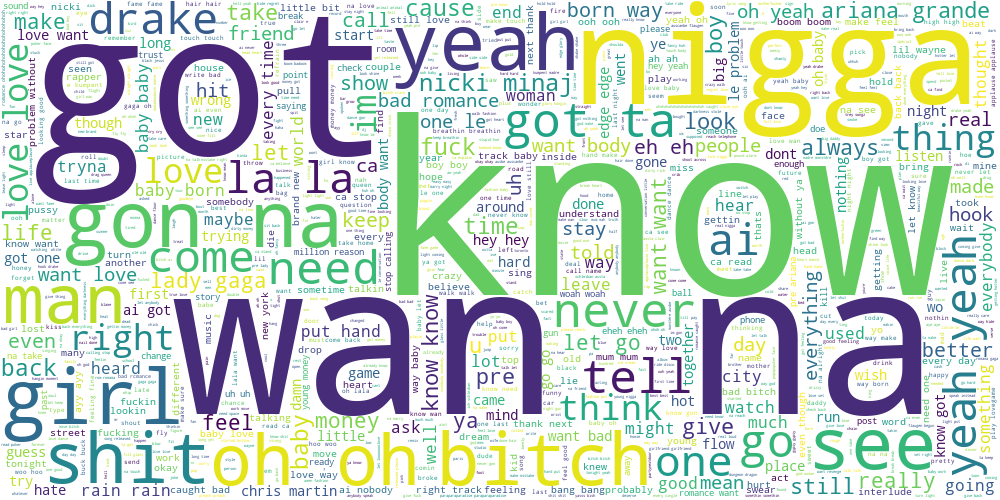

In [27]:
draw_wordcloud(data_songs.text)

Сори, у меня gensim сломал очень сильно джупитер, поэтому решение этого задания в другой тетрадке, я ее в колабе делала. Но там получилось, что разбиение другими способами в принципе работает нормально, у меня была не самая удачная выборка датасета, потому что как оказалось, он не очень хорошо разделим( Но было прикольно, что хотя бы нашла слова более романтичных песен и слова с типа матами)))

**Задание 7 (1 балл)**. Наконец, ставший ежегодной традицией социализационный бонус. Мы поощряем не только предметное, но и духовное развитие. Поэтому, чтобы заработать балл за это задание, сходите на какую-нибудь выставку или в музей, напишите небольшой отчетик о ваших впечатлениях и добавьте фотопруфы в ноутбук при сдаче. Можете объединиться с одногруппниками/однокурсниками, а также пригласить ассистентов/преподавателей, они тоже будут рады выбраться куда-нибудь. Для вдохновения приведем ссылку на актуальные выставки [новой](https://www.youtube.com/watch?v=dQw4w9WgXcQ&ab) и [старой Третьяковки](https://www.youtube.com/watch?v=xm3YgoEiEDc) (но совсем не обязательно посещать именно их).

Специально для вас мы решили сходить на небольшую выставку в ПГ. Конечно, там всего дай бог 10 экспонатов, но стоило удовольтвие всего 150 рублей и сам музей находится не в отдельном здании, а внутри арки у главного входа в парк горького. Более того, наверху есть смотровая площадка, но она была закрыта. 

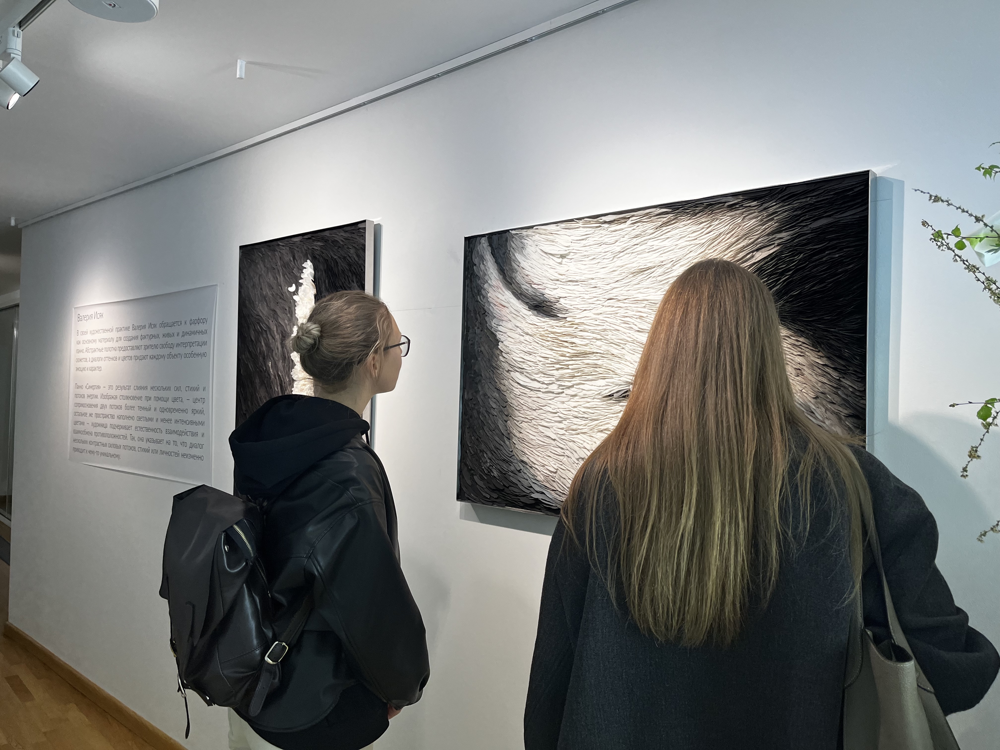

In [234]:
from IPython.display import Image
Image(filename='/Users/polinakrupica/Desktop/IMG_2074.jpg')

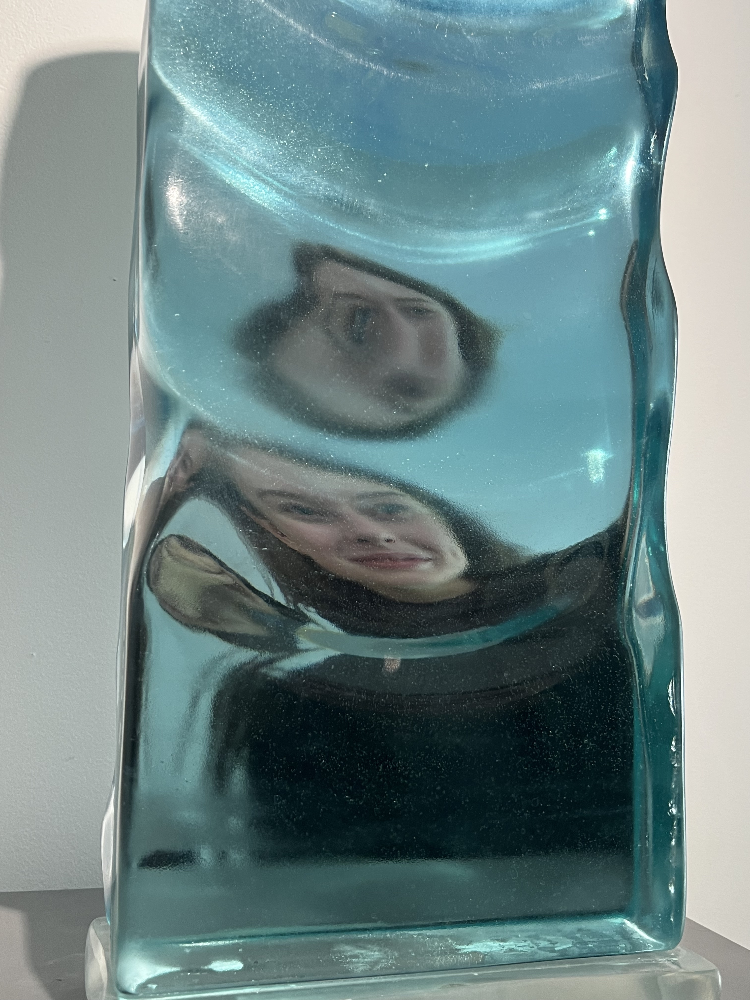

In [235]:
Image(filename='/Users/polinakrupica/Desktop/IMG_2078.jpg')